# Lead Scoring

## Problem Statement

An education company named X Education sells online courses to industry professionals. On any given day, many professionals who are interested in the courses land on their website and browse for courses.



The company markets its courses on several websites and search engines like Google. Once these people land on the website, they might browse the courses or fill up a form for the course or watch some videos. When these people fill up a form providing their email address or phone number, they are classified to be a lead. Moreover, the company also gets leads through past referrals. Once these leads are acquired, employees from the sales team start making calls, writing emails, etc. Through this process, some of the leads get converted while most do not. The typical lead conversion rate at X education is around 30%.



Now, although X Education gets a lot of leads, its lead conversion rate is very poor. For example, if, say, they acquire 100 leads in a day, only about 30 of them are converted. To make this process more efficient, the company wishes to identify the most potential leads, also known as ‘Hot Leads’. If they successfully identify this set of leads, the lead conversion rate should go up as the sales team will now be focusing more on communicating with the potential leads rather than making calls to everyone. A typical lead conversion process can be represented using the following funnel:


Lead Conversion Process - Demonstrated as a funnel
As you can see, there are a lot of leads generated in the initial stage (top) but only a few of them come out as paying customers from the bottom. In the middle stage, you need to nurture the potential leads well (i.e. educating the leads about the product, constantly communicating etc. ) in order to get a higher lead conversion.



X Education has appointed you to help them select the most promising leads, i.e. the leads that are most likely to convert into paying customers. The company requires you to build a model wherein you need to assign a lead score to each of the leads such that the customers with higher lead score have a higher conversion chance and the customers with lower lead score have a lower conversion chance. The CEO, in particular, has given a ballpark of the target lead conversion rate to be around 80%.



Data
You have been provided with a leads dataset from the past with around 9000 data points. This dataset consists of various attributes such as Lead Source, Total Time Spent on Website, Total Visits, Last Activity, etc. which may or may not be useful in ultimately deciding whether a lead will be converted or not. The target variable, in this case, is the column ‘Converted’ which tells whether a past lead was converted or not wherein 1 means it was converted and 0 means it wasn’t converted. You can learn more about the dataset from the data dictionary provided in the zip folder at the end of the page. Another thing that you also need to check out for are the levels present in the categorical variables. Many of the categorical variables have a level called 'Select' which needs to be handled because it is as good as a null value (think why?).

## Goals

There are quite a few goals for this case study.


Build a model to assign a lead score between 0 and 100 to each of the leads which can be used by the company to target potential leads. A higher score would mean that the lead is hot, i.e. is most likely to convert whereas a lower score would mean that the lead is cold and will mostly not get converted.
There are some more problems presented by the company which your model should be able to adjust to if the company's requirement changes in the future so you will need to handle these as well.

In [1]:
# Supress Warnings
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Importing libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
# visulaisation
from matplotlib.pyplot import xticks
%matplotlib inline

In [4]:
# Data display coustomization
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

## Data Preparation

### Data Loading

In [5]:
lead = pd.read_csv("Leads.csv")
lead.head()

,Prospect ID,Lead Number,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Last Activity,Country,Specialization,How did you hear about X Education,What is your current occupation,What matters most to you in choosing a course,Search,Magazine,Newspaper Article,X Education Forums,Newspaper,Digital Advertisement,Through Recommendations,Receive More Updates About Our Courses,Tags,Lead Quality,Update me on Supply Chain Content,Get updates on DM Content,Lead Profile,City,Asymmetrique Activity Index,Asymmetrique Profile Index,Asymmetrique Activity Score,Asymmetrique Profile Score,I agree to pay the amount through cheque,A free copy of Mastering The Interview,Last Notable Activity
0,7927b2df-8bba-4d29-b9a2-b6e0beafe620,660737,API,Olark Chat,No,No,0,0.0,0,0.0,Page Visited on Website,NaN,Select,Select,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Interested in other courses,Low in Relevance,No,No,Select,Select,02.Medium,02.Medium,15.0,15.0,No,No,Modified
1,2a272436-5132-4136-86fa-dcc88c88f482,660728,API,Organic Search,No,No,0,5.0,674,2.5,Email Opened,India,Select,Select,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Ringing,NaN,No,No,Select,Select,02.Medium,02.Medium,15.0,15.0,No,No,Email Opened
2,8cc8c611-a219-4f35-ad23-fdfd2656bd8a,660727,Landing Page Submission,Direct Traffic,No,No,1,2.0,1532,2.0,Email Opened,India,Business Administration,Select,Student,Better Career Prospects,No,No,No,No,No,No,No,No,Will revert after reading the email,Might be,No,No,Potential Lead,Mumbai,02.Medium,01.High,14.0,20.0,No,Yes,Email Opened
3,0cc2df48-7cf4-4e39-9de9-19797f9b38cc,660719,Landing Page Submission,Direct Traffic,No,No,0,1.0,305,1.0,Unreachable,India,Media and Advertising,Word Of Mouth,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Ringing,Not Sure,No,No,Select,Mumbai,02.Medium,01.High,13.0,17.0,No,No,Modified
4,3256f628-e534-4826-9d63-4a8b88782852,660681,Landing Page Submission,Google,No,No,1,2.0,1428,1.0,Converted to Lead,India,Select,Other,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Will revert after reading the email,Might be,No,No,Select,Mumbai,02.Medium,01.High,15.0,18.0,No,No,Modified


## Duplicate Check

In [6]:
lead_dub = lead.copy()

# Checking for duplicates and dropping the entire duplicate row if any
lead_dub.drop_duplicates(subset=None, inplace=True)
lead_dub.shape

(9240, 37)

In [7]:
lead.shape

(9240, 37)

The shape after running the drop duplicate command is same as the original dataframe.

Hence we can conclude that there were zero duplicate values in the dataset.

## Data Inspection

In [8]:
lead.shape

(9240, 37)

In [9]:
lead.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9240 entries, 0 to 9239
Data columns (total 37 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   Prospect ID                                    9240 non-null   object 
 1   Lead Number                                    9240 non-null   int64  
 2   Lead Origin                                    9240 non-null   object 
 3   Lead Source                                    9204 non-null   object 
 4   Do Not Email                                   9240 non-null   object 
 5   Do Not Call                                    9240 non-null   object 
 6   Converted                                      9240 non-null   int64  
 7   TotalVisits                                    9103 non-null   float64
 8   Total Time Spent on Website                    9240 non-null   int64  
 9   Page Views Per Visit                           9103 

In [10]:
lead.describe()

,Lead Number,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Asymmetrique Activity Score,Asymmetrique Profile Score
count,9240.000000,9240.000000,9103.000000,9240.000000,9103.000000,5022.000000,5022.000000
mean,617188.435606,0.385390,3.445238,487.698268,2.362820,14.306252,16.344883
std,23405.995698,0.486714,4.854853,548.021466,2.161418,1.386694,1.811395
min,579533.000000,0.000000,0.000000,0.000000,0.000000,7.000000,11.000000
25%,596484.500000,0.000000,1.000000,12.000000,1.000000,14.000000,15.000000
50%,615479.000000,0.000000,3.000000,248.000000,2.000000,14.000000,16.000000
75%,637387.250000,1.000000,5.000000,936.000000,3.000000,15.000000,18.000000
max,660737.000000,1.000000,251.000000,2272.000000,55.000000,18.000000,20.000000


## Data Cleaning

In [11]:
# As we can observe that there are select values for many column.
#This is because customer did not select any option from the list, hence it shows select.
# Select values are as good as NULL.

# Converting 'Select' values to NaN.
lead = lead.replace('Select', np.nan)
lead.head()

,Prospect ID,Lead Number,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Last Activity,Country,Specialization,How did you hear about X Education,What is your current occupation,What matters most to you in choosing a course,Search,Magazine,Newspaper Article,X Education Forums,Newspaper,Digital Advertisement,Through Recommendations,Receive More Updates About Our Courses,Tags,Lead Quality,Update me on Supply Chain Content,Get updates on DM Content,Lead Profile,City,Asymmetrique Activity Index,Asymmetrique Profile Index,Asymmetrique Activity Score,Asymmetrique Profile Score,I agree to pay the amount through cheque,A free copy of Mastering The Interview,Last Notable Activity
0,7927b2df-8bba-4d29-b9a2-b6e0beafe620,660737,API,Olark Chat,No,No,0,0.0,0,0.0,Page Visited on Website,NaN,NaN,NaN,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Interested in other courses,Low in Relevance,No,No,NaN,NaN,02.Medium,02.Medium,15.0,15.0,No,No,Modified
1,2a272436-5132-4136-86fa-dcc88c88f482,660728,API,Organic Search,No,No,0,5.0,674,2.5,Email Opened,India,NaN,NaN,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Ringing,NaN,No,No,NaN,NaN,02.Medium,02.Medium,15.0,15.0,No,No,Email Opened
2,8cc8c611-a219-4f35-ad23-fdfd2656bd8a,660727,Landing Page Submission,Direct Traffic,No,No,1,2.0,1532,2.0,Email Opened,India,Business Administration,NaN,Student,Better Career Prospects,No,No,No,No,No,No,No,No,Will revert after reading the email,Might be,No,No,Potential Lead,Mumbai,02.Medium,01.High,14.0,20.0,No,Yes,Email Opened
3,0cc2df48-7cf4-4e39-9de9-19797f9b38cc,660719,Landing Page Submission,Direct Traffic,No,No,0,1.0,305,1.0,Unreachable,India,Media and Advertising,Word Of Mouth,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Ringing,Not Sure,No,No,NaN,Mumbai,02.Medium,01.High,13.0,17.0,No,No,Modified
4,3256f628-e534-4826-9d63-4a8b88782852,660681,Landing Page Submission,Google,No,No,1,2.0,1428,1.0,Converted to Lead,India,NaN,Other,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Will revert after reading the email,Might be,No,No,NaN,Mumbai,02.Medium,01.High,15.0,18.0,No,No,Modified


In [12]:
lead.isnull().sum()

Prospect ID                                         0
Lead Number                                         0
Lead Origin                                         0
Lead Source                                        36
Do Not Email                                        0
Do Not Call                                         0
Converted                                           0
TotalVisits                                       137
Total Time Spent on Website                         0
Page Views Per Visit                              137
Last Activity                                     103
Country                                          2461
Specialization                                   3380
How did you hear about X Education               7250
What is your current occupation                  2690
What matters most to you in choosing a course    2709
Search                                              0
Magazine                                            0
Newspaper Article           

In [13]:
round(100*(lead.isnull().sum()/len(lead.index)), 2)

Prospect ID                                       0.00
Lead Number                                       0.00
Lead Origin                                       0.00
Lead Source                                       0.39
Do Not Email                                      0.00
Do Not Call                                       0.00
Converted                                         0.00
TotalVisits                                       1.48
Total Time Spent on Website                       0.00
Page Views Per Visit                              1.48
Last Activity                                     1.11
Country                                          26.63
Specialization                                   36.58
How did you hear about X Education               78.46
What is your current occupation                  29.11
What matters most to you in choosing a course    29.32
Search                                            0.00
Magazine                                          0.00
Newspaper 

In [14]:
# we will drop the columns having more than 40% NA values.
lead = lead.drop(columns=lead.loc[:,list(round(100*(lead.isnull().sum()/len(lead.index)), 2)>40)].columns) #axis argument is not necessary

In [15]:
round(100*(lead.isnull().sum()/len(lead.index)), 2)

Prospect ID                                       0.00
Lead Number                                       0.00
Lead Origin                                       0.00
Lead Source                                       0.39
Do Not Email                                      0.00
Do Not Call                                       0.00
Converted                                         0.00
TotalVisits                                       1.48
Total Time Spent on Website                       0.00
Page Views Per Visit                              1.48
Last Activity                                     1.11
Country                                          26.63
Specialization                                   36.58
What is your current occupation                  29.11
What matters most to you in choosing a course    29.32
Search                                            0.00
Magazine                                          0.00
Newspaper Article                                 0.00
X Educatio

In [16]:
lead.drop(['Prospect ID', 'Lead Number'], axis=1, inplace=True)

In [17]:
lead.head()

,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Last Activity,Country,Specialization,What is your current occupation,What matters most to you in choosing a course,Search,Magazine,Newspaper Article,X Education Forums,Newspaper,Digital Advertisement,Through Recommendations,Receive More Updates About Our Courses,Tags,Update me on Supply Chain Content,Get updates on DM Content,City,I agree to pay the amount through cheque,A free copy of Mastering The Interview,Last Notable Activity
0,API,Olark Chat,No,No,0,0.0,0,0.0,Page Visited on Website,NaN,NaN,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Interested in other courses,No,No,NaN,No,No,Modified
1,API,Organic Search,No,No,0,5.0,674,2.5,Email Opened,India,NaN,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Ringing,No,No,NaN,No,No,Email Opened
2,Landing Page Submission,Direct Traffic,No,No,1,2.0,1532,2.0,Email Opened,India,Business Administration,Student,Better Career Prospects,No,No,No,No,No,No,No,No,Will revert after reading the email,No,No,Mumbai,No,Yes,Email Opened
3,Landing Page Submission,Direct Traffic,No,No,0,1.0,305,1.0,Unreachable,India,Media and Advertising,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Ringing,No,No,Mumbai,No,No,Modified
4,Landing Page Submission,Google,No,No,1,2.0,1428,1.0,Converted to Lead,India,NaN,Unemployed,Better Career Prospects,No,No,No,No,No,No,No,No,Will revert after reading the email,No,No,Mumbai,No,No,Modified


Now we will take care of null values in each column one by one.


In [18]:
round(100*(lead.isnull().sum()/len(lead.index)), 2)

Lead Origin                                       0.00
Lead Source                                       0.39
Do Not Email                                      0.00
Do Not Call                                       0.00
Converted                                         0.00
TotalVisits                                       1.48
Total Time Spent on Website                       0.00
Page Views Per Visit                              1.48
Last Activity                                     1.11
Country                                          26.63
Specialization                                   36.58
What is your current occupation                  29.11
What matters most to you in choosing a course    29.32
Search                                            0.00
Magazine                                          0.00
Newspaper Article                                 0.00
X Education Forums                                0.00
Newspaper                                         0.00
Digital Ad

In [19]:
# City

In [20]:
lead.City.value_counts()


City
Mumbai                         3222
Thane & Outskirts               752
Other Cities                    686
Other Cities of Maharashtra     457
Other Metro Cities              380
Tier II Cities                   74
Name: count, dtype: int64

In [21]:
lead.City.describe()

count       5571
unique         6
top       Mumbai
freq        3222
Name: City, dtype: object

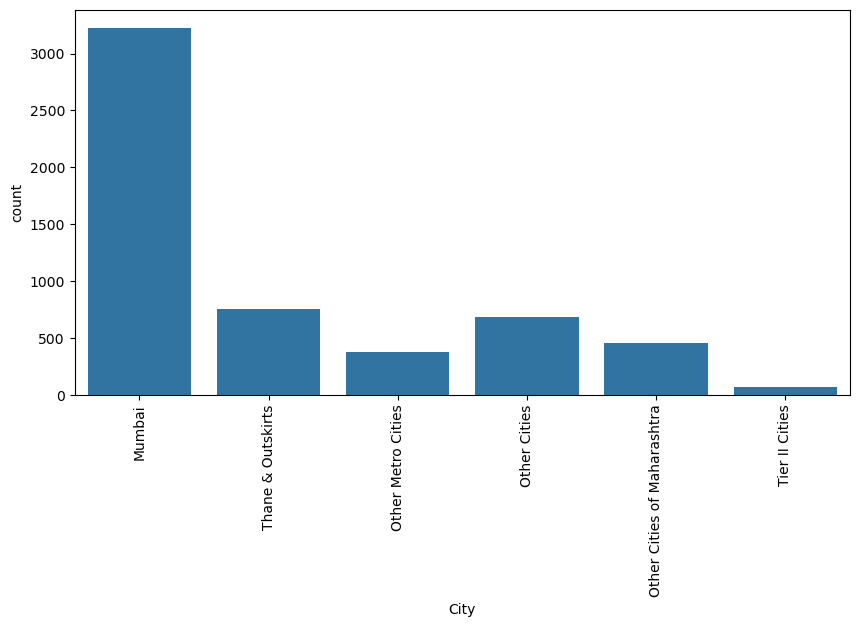

In [22]:
# countplot of city

plt.figure(figsize=(10,5))
sns.countplot(x='City', data=lead)
xticks(rotation=90)
plt.show()

In [23]:
# Around 57.8% of the data available  is Mumbai so we can impute Mumbai in the missing values.

In [24]:
lead['City'] = lead['City'].replace(np.nan, 'Mumbai')

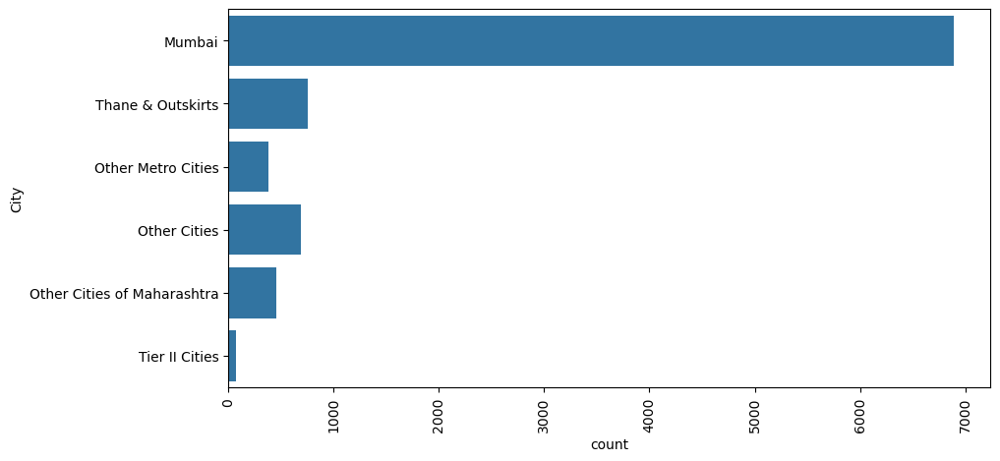

In [25]:
plt.figure(figsize = (10,5))
ax= sns.countplot(lead['City'])
plt.xticks(rotation = 90)
plt.show()

In [26]:
# Specailization

In [27]:
lead.Specialization.describe()

count                   5860
unique                    18
top       Finance Management
freq                     976
Name: Specialization, dtype: object

In [28]:
lead.Specialization.value_counts()

Specialization
Finance Management                   976
Human Resource Management            848
Marketing Management                 838
Operations Management                503
Business Administration              403
IT Projects Management               366
Supply Chain Management              349
Banking, Investment And Insurance    338
Travel and Tourism                   203
Media and Advertising                203
International Business               178
Healthcare Management                159
Hospitality Management               114
E-COMMERCE                           112
Retail Management                    100
Rural and Agribusiness                73
E-Business                            57
Services Excellence                   40
Name: count, dtype: int64

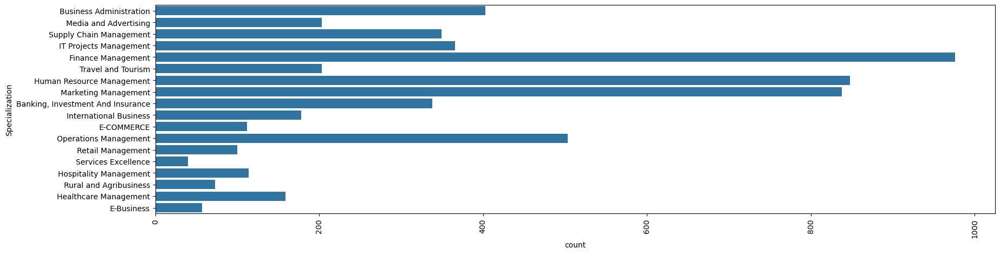

In [29]:
plt.figure(figsize = (20,5))
ax= sns.countplot(lead['Specialization'])
plt.xticks(rotation = 90)
plt.show()

In [30]:
# It maybe the case that lead has not entered any specialization if his/her option is not availabe on the list,
#  may not have any specialization or is a student.
# Hence we can make a category "Others" for missing values.


In [31]:
lead['Specialization'] = lead['Specialization'].replace(np.nan, 'Others')

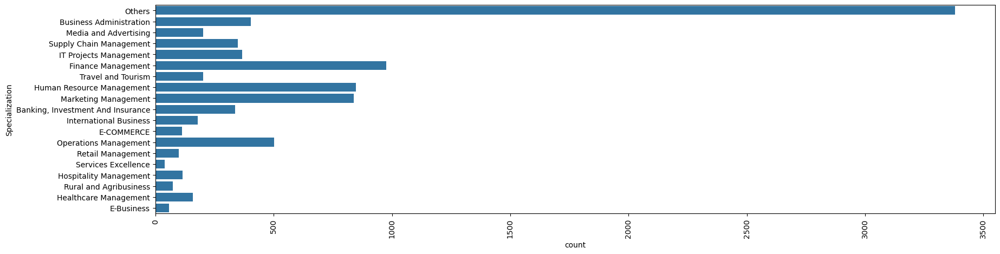

In [32]:
plt.figure(figsize = (20,5))
ax= sns.countplot(lead['Specialization'])

plt.xticks(rotation = 90)
plt.show()

In [33]:
round(100*(lead.isnull().sum()/len(lead.index)), 2)

Lead Origin                                       0.00
Lead Source                                       0.39
Do Not Email                                      0.00
Do Not Call                                       0.00
Converted                                         0.00
TotalVisits                                       1.48
Total Time Spent on Website                       0.00
Page Views Per Visit                              1.48
Last Activity                                     1.11
Country                                          26.63
Specialization                                    0.00
What is your current occupation                  29.11
What matters most to you in choosing a course    29.32
Search                                            0.00
Magazine                                          0.00
Newspaper Article                                 0.00
X Education Forums                                0.00
Newspaper                                         0.00
Digital Ad

In [34]:
# What matters most to you in choosing a course

In [35]:
lead['What matters most to you in choosing a course'].describe()

count                        6531
unique                          3
top       Better Career Prospects
freq                         6528
Name: What matters most to you in choosing a course, dtype: object

In [36]:
lead['What matters most to you in choosing a course'].value_counts()

What matters most to you in choosing a course
Better Career Prospects      6528
Flexibility & Convenience       2
Other                           1
Name: count, dtype: int64

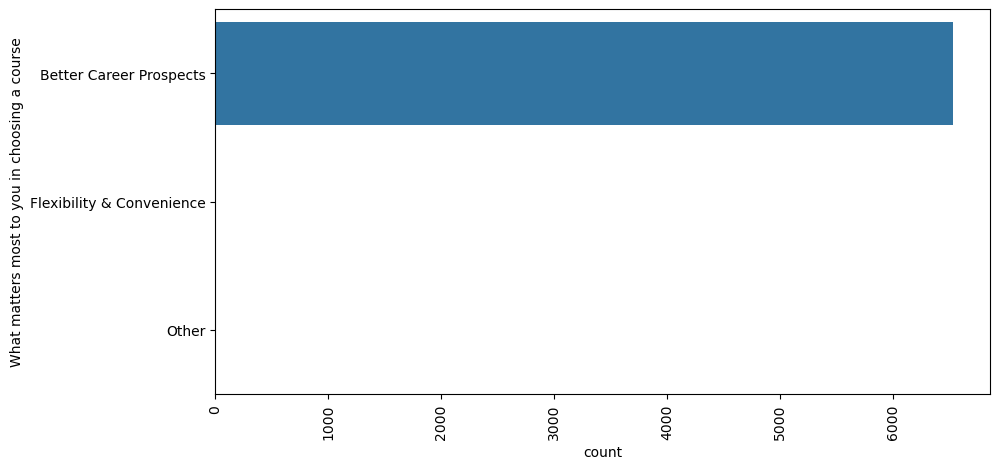

In [37]:
plt.figure(figsize = (10,5))
ax= sns.countplot(lead['What matters most to you in choosing a course'])

plt.xticks(rotation = 90)

plt.show()

In [38]:
# Blanks in the this column may be imputed by 'Better Career Prospects'.

In [39]:
lead['What matters most to you in choosing a course'] = lead['What matters most to you in choosing a course'].replace(np.nan, 'Better Career Prospects')

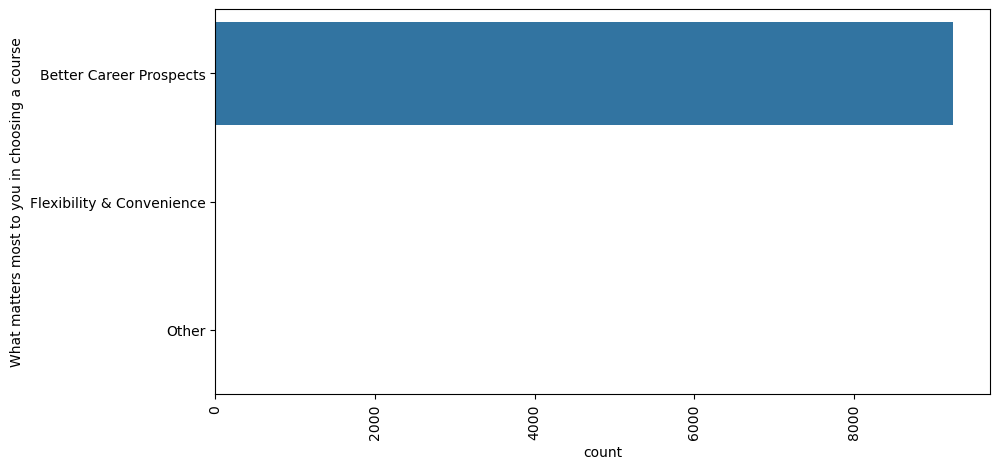

In [40]:
plt.figure(figsize = (10,5))
ax= sns.countplot(lead['What matters most to you in choosing a course'])

plt.xticks(rotation = 90)

plt.show()

In [41]:
# Occupation

In [42]:
lead['What is your current occupation'].describe()

count           6550
unique             6
top       Unemployed
freq            5600
Name: What is your current occupation, dtype: object

In [43]:
lead['What is your current occupation'].value_counts()

What is your current occupation
Unemployed              5600
Working Professional     706
Student                  210
Other                     16
Housewife                 10
Businessman                8
Name: count, dtype: int64

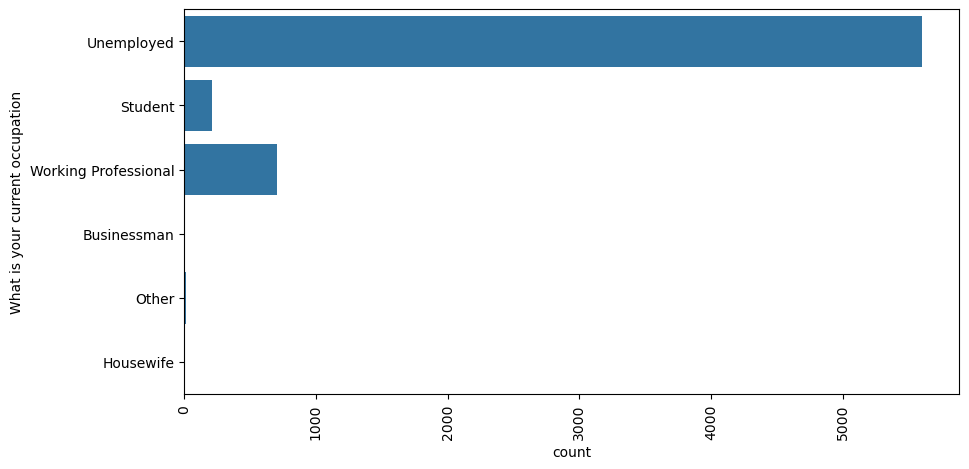

In [44]:
plt.figure(figsize = (10,5))
ax= sns.countplot(lead['What is your current occupation'])

plt.xticks(rotation = 90)

plt.show()

In [45]:
# 86% entries are of Unemployed so we can impute "Unemployed" in it.

In [46]:
lead['What is your current occupation'] = lead['What is your current occupation'].replace(np.nan, 'Unemployed')

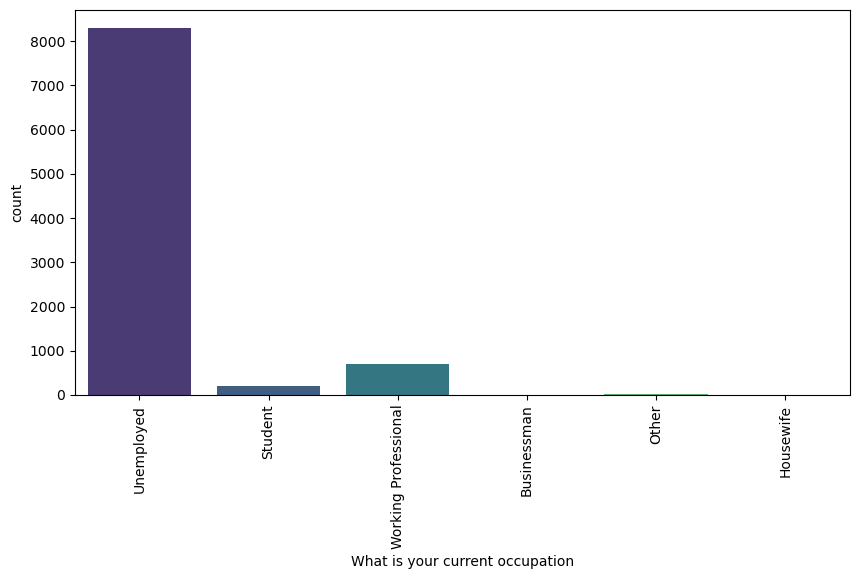

In [47]:
plt.figure(figsize=(10, 5))
ax = sns.countplot(x='What is your current occupation', data=lead, palette='viridis') # Added palette for color
plt.xticks(rotation=90)
plt.show()

In [48]:
# Country

In [49]:
lead['Country'].describe()

count      6779
unique       38
top       India
freq       6492
Name: Country, dtype: object

In [50]:
lead['Country'].value_counts()

Country
India                   6492
United States             69
United Arab Emirates      53
Singapore                 24
Saudi Arabia              21
United Kingdom            15
Australia                 13
Qatar                     10
Hong Kong                  7
Bahrain                    7
Oman                       6
France                     6
unknown                    5
South Africa               4
Nigeria                    4
Germany                    4
Kuwait                     4
Canada                     4
Sweden                     3
China                      2
Asia/Pacific Region        2
Uganda                     2
Bangladesh                 2
Italy                      2
Belgium                    2
Netherlands                2
Ghana                      2
Philippines                2
Russia                     1
Switzerland                1
Vietnam                    1
Denmark                    1
Tanzania                   1
Liberia                    1
Malays

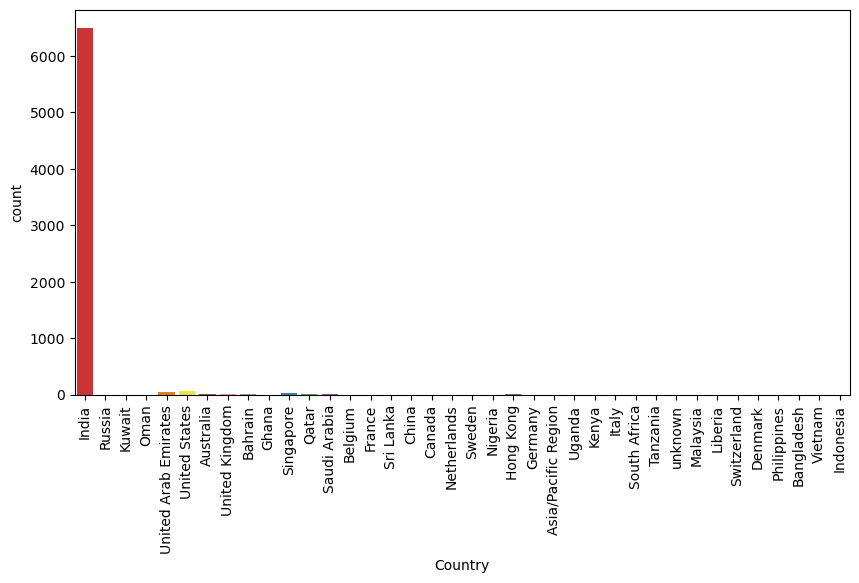

In [51]:
# prompt: colorfull countplot for country for better repersentation

plt.figure(figsize=(10, 5))
ax = sns.countplot(x='Country', data=lead, palette='Set1') # Using 'Set2' palette for better color differentiation
plt.xticks(rotation=90)
plt.show()

In [52]:
# Country is India for most values so let's impute the same in missing values.
lead['Country'] = lead['Country'].replace(np.nan, 'India')

plt.figure(figsize=(10, 5))
ax = sns.countplot(x='Country', data=lead, palette='Set2') # Using 'Set2' palette for better color differentiation
plt.xticks(rotation=90)
plt.show()

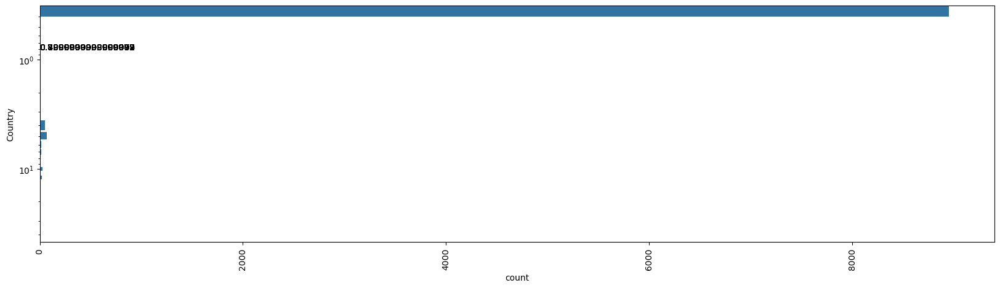

In [53]:
plt.figure(figsize = (20,5))
ax= sns.countplot(lead['Country'])
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

In [54]:
round(100*(lead.isnull().sum()/len(lead.index)), 2)

Lead Origin                                       0.00
Lead Source                                       0.39
Do Not Email                                      0.00
Do Not Call                                       0.00
Converted                                         0.00
TotalVisits                                       1.48
Total Time Spent on Website                       0.00
Page Views Per Visit                              1.48
Last Activity                                     1.11
Country                                           0.00
Specialization                                    0.00
What is your current occupation                   0.00
What matters most to you in choosing a course     0.00
Search                                            0.00
Magazine                                          0.00
Newspaper Article                                 0.00
X Education Forums                                0.00
Newspaper                                         0.00
Digital Ad

In [55]:
lead.isnull().sum()

Lead Origin                                         0
Lead Source                                        36
Do Not Email                                        0
Do Not Call                                         0
Converted                                           0
TotalVisits                                       137
Total Time Spent on Website                         0
Page Views Per Visit                              137
Last Activity                                     103
Country                                             0
Specialization                                      0
What is your current occupation                     0
What matters most to you in choosing a course       0
Search                                              0
Magazine                                            0
Newspaper Article                                   0
X Education Forums                                  0
Newspaper                                           0
Digital Advertisement       

In [56]:
# Rest missing values are under 1.5% so we can drop these rows.
lead.dropna(inplace = True)

In [57]:
round(100*(lead.isnull().sum()/len(lead.index)), 2)

Lead Origin                                      0.0
Lead Source                                      0.0
Do Not Email                                     0.0
Do Not Call                                      0.0
Converted                                        0.0
TotalVisits                                      0.0
Total Time Spent on Website                      0.0
Page Views Per Visit                             0.0
Last Activity                                    0.0
Country                                          0.0
Specialization                                   0.0
What is your current occupation                  0.0
What matters most to you in choosing a course    0.0
Search                                           0.0
Magazine                                         0.0
Newspaper Article                                0.0
X Education Forums                               0.0
Newspaper                                        0.0
Digital Advertisement                         

In [58]:
lead.isnull().sum()

Lead Origin                                      0
Lead Source                                      0
Do Not Email                                     0
Do Not Call                                      0
Converted                                        0
TotalVisits                                      0
Total Time Spent on Website                      0
Page Views Per Visit                             0
Last Activity                                    0
Country                                          0
Specialization                                   0
What is your current occupation                  0
What matters most to you in choosing a course    0
Search                                           0
Magazine                                         0
Newspaper Article                                0
X Education Forums                               0
Newspaper                                        0
Digital Advertisement                            0
Through Recommendations        

In [59]:
data_retailed= len(lead)* 100 / len(lead_dub)
print("{} % of original rows is available for EDA".format(round(data_retailed,2)))

62.2 % of original rows is available for EDA


In [60]:
lead.shape

(5747, 28)

Now Data is free from all missing value  and we can start with the analysis

# Exploratory Data Analytics

## Univariate Analysis

### Converted

In [61]:
# Converted is the target variable, Indicates whether a lead has been successfully converted (1) or not (0).

In [62]:
Converted = round((sum(lead['Converted'])/len(lead['Converted'].index))*100,2)

print("We have almost {} %  Converted rate".format(Converted))



We have almost 45.5 %  Converted rate


### Lead Origin

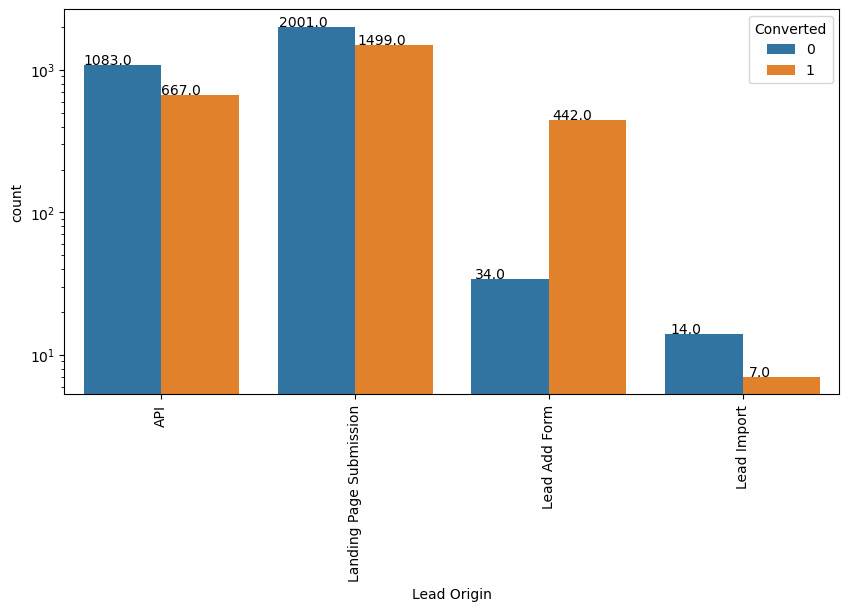

In [63]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "Lead Origin", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- API and Landing Page Submission have 30-35% conversion rate but count of lead originated from them are considerable.
- Lead Add Form has more than 90% conversion rate but count of lead are not very high.
- Lead Import are very less in count.

**To improve overall lead conversion rate, we need to focus more on improving lead converion of API and Landing Page Submission origin and generate more leads from Lead Add Form.**

## Lead Source

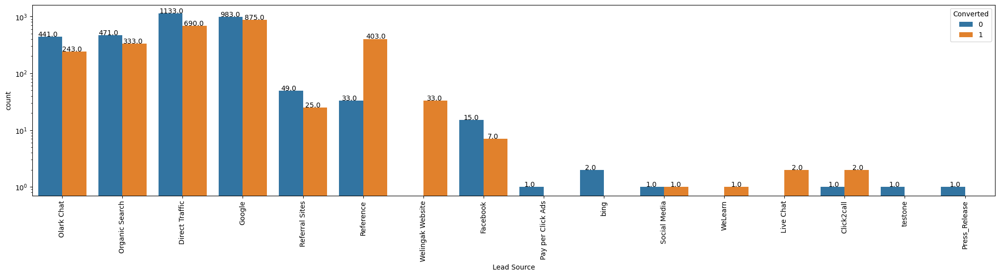

In [64]:
plt.figure(figsize = (25,5))
ax= sns.countplot(x = "Lead Source", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

In [65]:
lead['Lead Source'] = lead['Lead Source'].replace(['google'], 'Google')
lead['Lead Source'] = lead['Lead Source'].replace(['Click2call', 'Live Chat', 'NC_EDM', 'Pay per Click Ads', 'Press_Release',
  'Social Media', 'WeLearn', 'bing', 'blog', 'testone', 'welearnblog_Home', 'youtubechannel'], 'Others')

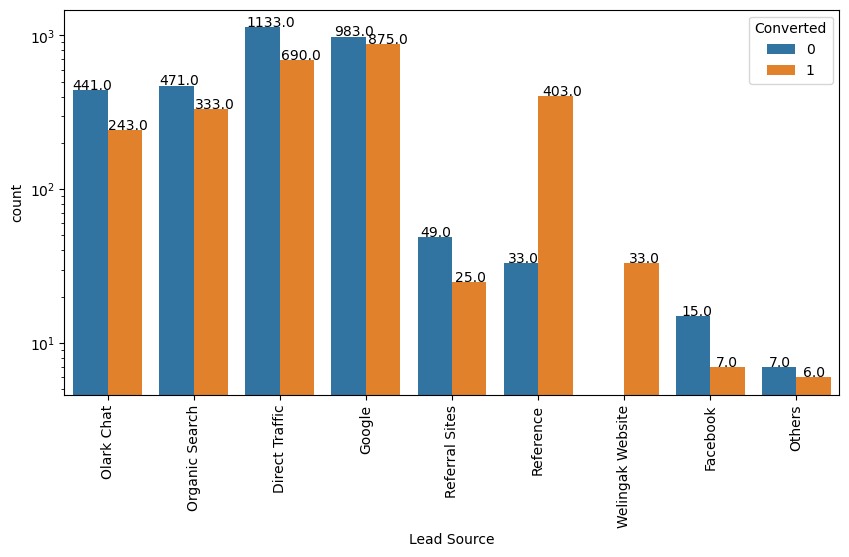

In [66]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "Lead Source", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Google and Direct traffic generates maximum number of leads.
- Conversion Rate of reference leads and leads through welingak website is high.

**To improve overall lead conversion rate, focus should be on improving lead converion of olark chat, organic search, direct traffic, and google leads and generate more leads from reference and welingak website.**

## Do Not Email & Do Not Call

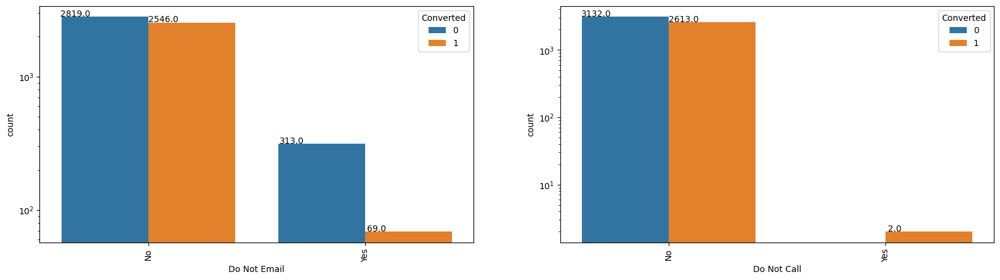

In [67]:
plt.figure(figsize = (20,5))
plt.subplot(1,2,1)
ax= sns.countplot(x = "Do Not Email", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.subplot(1,2,2)
ax= sns.countplot(x = "Do Not Call", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

## Total Visits

In [68]:
lead['TotalVisits'].describe(percentiles=[0.05,.25, .5, .75, .90, .95, .99])

count    5747.000000
mean        3.727336
std         4.907139
min         0.000000
5%          0.000000
25%         2.000000
50%         3.000000
75%         5.000000
90%         8.000000
95%        10.000000
99%        17.540000
max       251.000000
Name: TotalVisits, dtype: float64

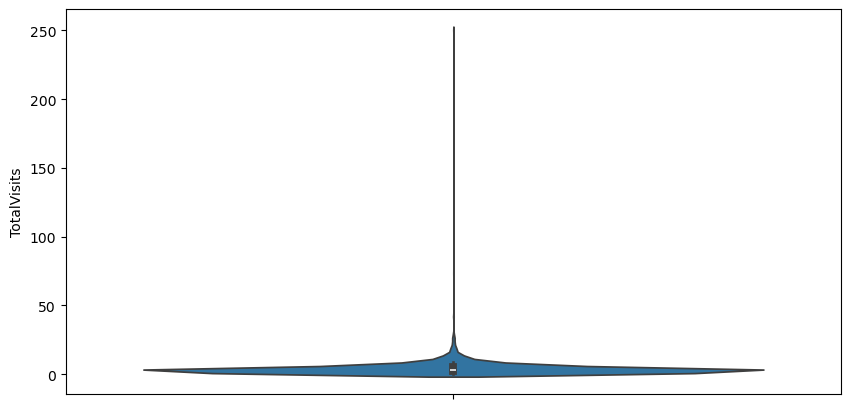

In [69]:
plt.figure(figsize = (10,5))
sns.violinplot(lead['TotalVisits'])
plt.show()

In [70]:
# As we can see there are a number of outliers in the data.
# We will cap the outliers to 95% value for analysis.

In [71]:
percentiles = lead['TotalVisits'].quantile([0.05,0.95]).values
lead['TotalVisits'][lead['TotalVisits'] <= percentiles[0]] = percentiles[0]
lead['TotalVisits'][lead['TotalVisits'] >= percentiles[1]] = percentiles[1]

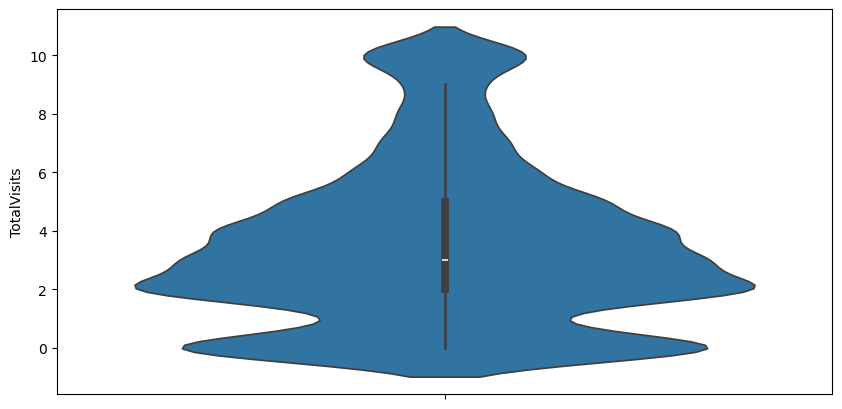

In [72]:
plt.figure(figsize = (10,5))
sns.violinplot(lead['TotalVisits'])
plt.show()

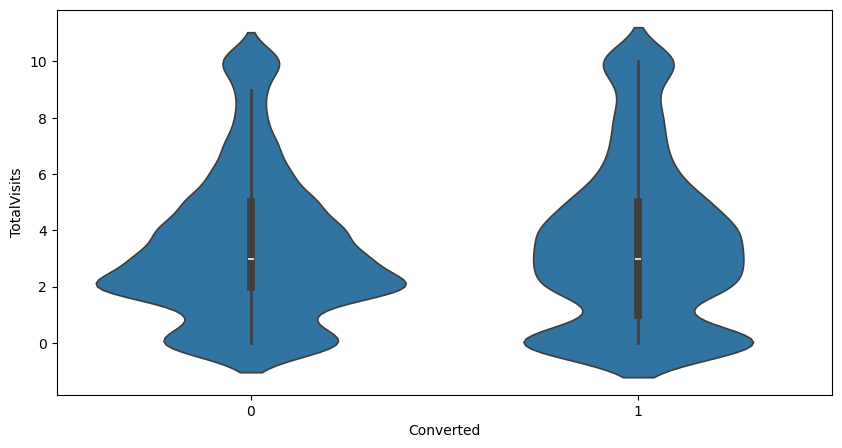

In [73]:
plt.figure(figsize = (10,5))
sns.violinplot(y = 'TotalVisits', x = 'Converted', data = lead)
plt.show()

- Median for converted and not converted leads are the same.

**Nothng conclusive can be said on the basis of Total Visits.**

## Total time spent on website

In [74]:
lead['Total Time Spent on Website'].describe()

count    5747.000000
mean      546.275448
std       564.053620
min         0.000000
25%        57.000000
50%       300.000000
75%      1030.000000
max      2272.000000
Name: Total Time Spent on Website, dtype: float64

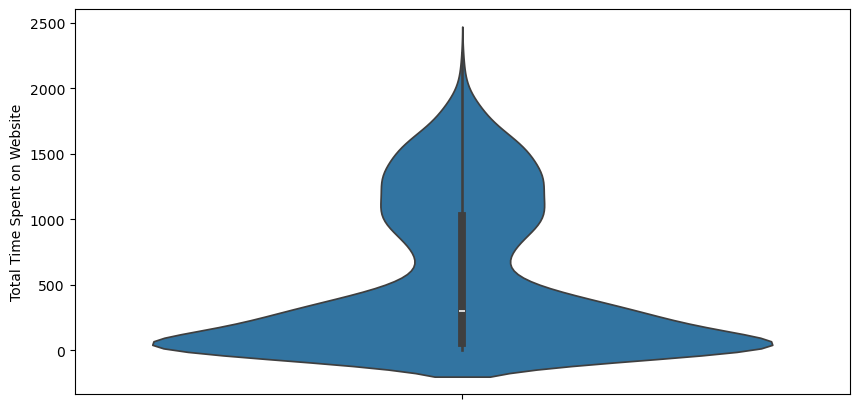

In [75]:
plt.figure(figsize = (10,5))
sns.violinplot(lead['Total Time Spent on Website'])
plt.show()

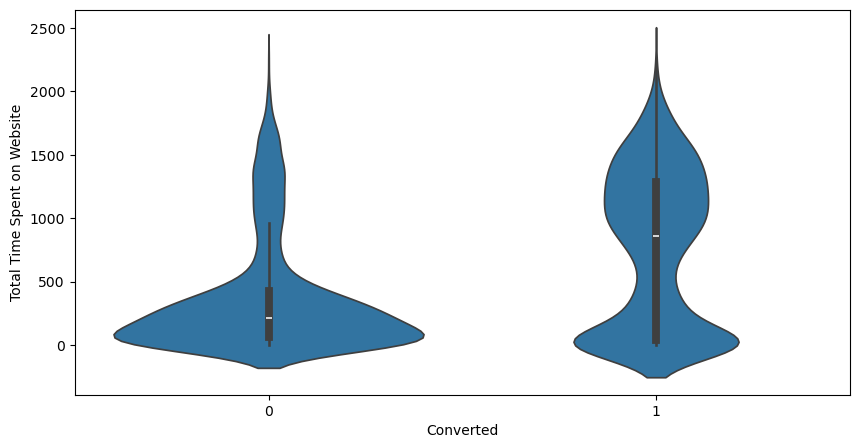

In [76]:
plt.figure(figsize = (10,5))
sns.violinplot(y = 'Total Time Spent on Website', x = 'Converted', data = lead)
plt.show()

- Leads spending more time on the weblise are more likely to be converted.

**Website should be made more engaging to make leads spend more time.**

## Page views per visit

In [77]:
lead['Page Views Per Visit'].describe()

count    5747.000000
mean        2.579245
std         2.062009
min         0.000000
25%         1.250000
50%         2.000000
75%         4.000000
max        16.000000
Name: Page Views Per Visit, dtype: float64

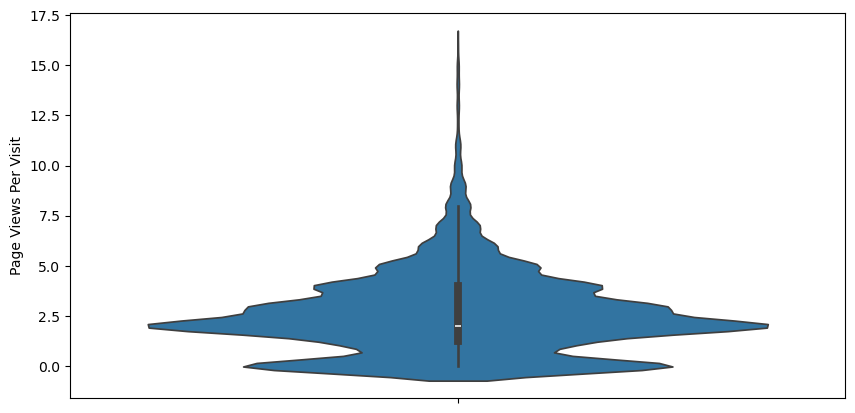

In [78]:
plt.figure(figsize = (10,5))
sns.violinplot(lead['Page Views Per Visit'])
plt.show()

In [79]:
# As we can see there are a number of outliers in the data.
# We will cap the outliers to 95% value for analysis.

In [80]:
percentiles = lead['Page Views Per Visit'].quantile([0.05,0.95]).values
lead['Page Views Per Visit'][lead['Page Views Per Visit'] <= percentiles[0]] = percentiles[0]
lead['Page Views Per Visit'][lead['Page Views Per Visit'] >= percentiles[1]] = percentiles[1]

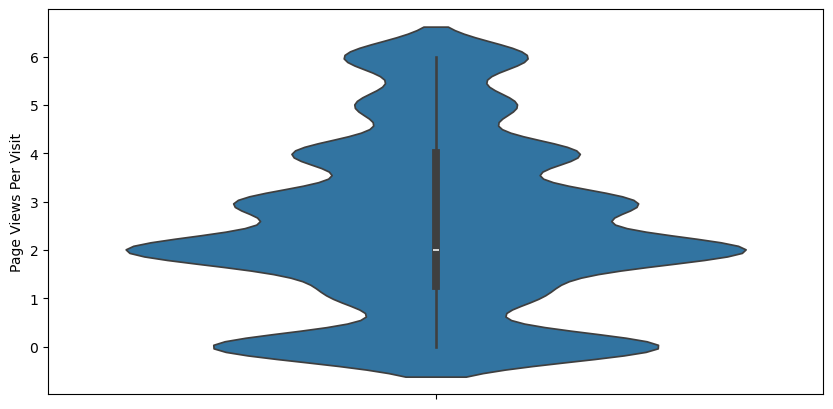

In [81]:
plt.figure(figsize = (10,5))
sns.violinplot(lead['Page Views Per Visit'])
plt.show()

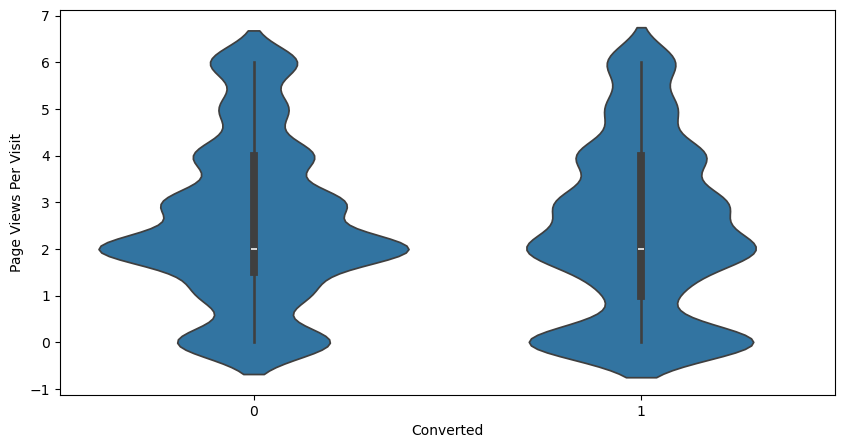

In [82]:
plt.figure(figsize = (10,5))
sns.violinplot(y = 'Page Views Per Visit', x = 'Converted', data = lead)
plt.show()

- Median for converted and unconverted leads is the same.

**Nothing can be said specifically for lead conversion from Page Views Per Visit**

## Last Activity

In [83]:
lead['Last Activity'].describe()

count             5747
unique              17
top       Email Opened
freq              2221
Name: Last Activity, dtype: object

In [84]:
lead['Last Activity'].value_counts()

Last Activity
Email Opened                    2221
SMS Sent                        1902
Page Visited on Website          410
Olark Chat Conversation          376
Converted to Lead                289
Email Link Clicked               168
Email Bounced                    155
Form Submitted on Website         79
Unreachable                       70
Unsubscribed                      40
Had a Phone Conversation          23
Approached upfront                 5
View in browser link Clicked       3
Email Received                     2
Email Marked Spam                  2
Visited Booth in Tradeshow         1
Resubscribed to emails             1
Name: count, dtype: int64

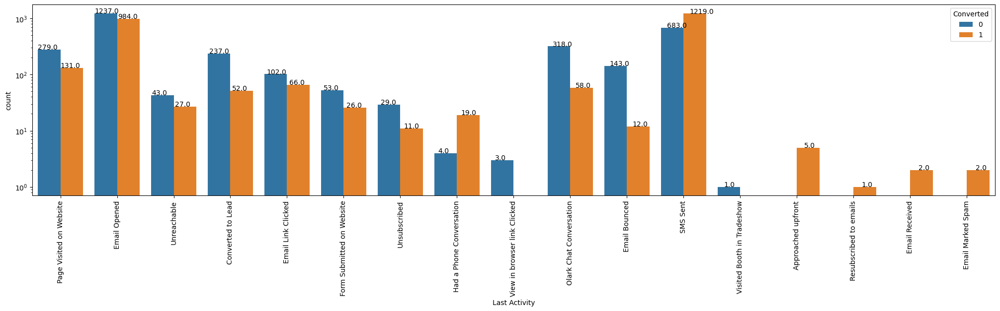

In [85]:
plt.figure(figsize = (25,5))
ax= sns.countplot(x = "Last Activity", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

In [86]:
# Let's keep considerable last activities as such and club all others to "Other_Activity"
lead['Last Activity'] = lead['Last Activity'].replace(['Had a Phone Conversation', 'View in browser link Clicked',
                                                       'Visited Booth in Tradeshow', 'Approached upfront',
                                                       'Resubscribed to emails','Email Received', 'Email Marked Spam'],
                                                      'Other_Activity')

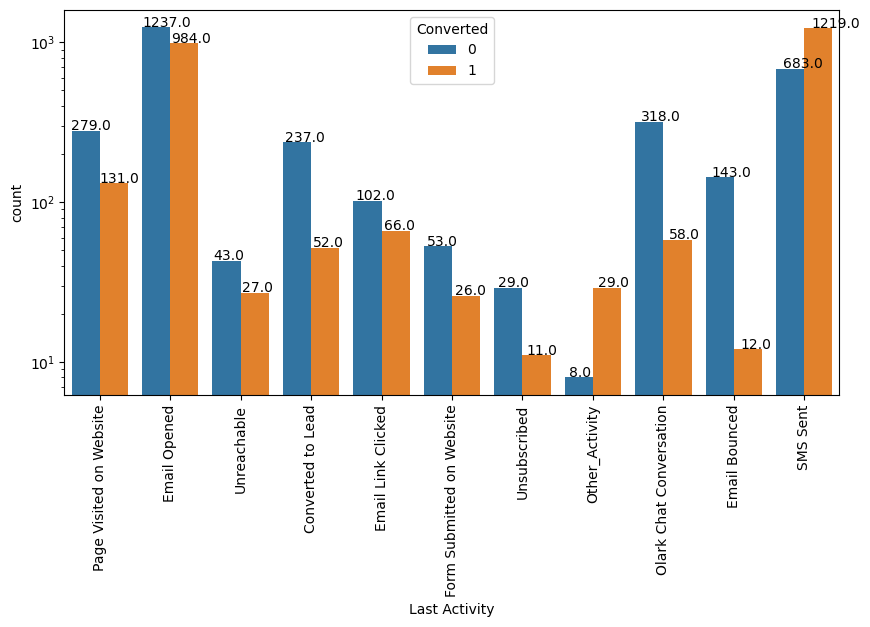

In [87]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "Last Activity", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Most of the lead have their Email opened as their last activity.
- Conversion rate for leads with last activity as SMS Sent is almost 62%.

## Country

In [88]:
lead.Country.describe()

count      5747
unique       32
top       India
freq       5554
Name: Country, dtype: object

In [89]:
lead.Country.value_counts()

Country
India                   5554
United States             43
United Arab Emirates      38
Singapore                 16
Saudi Arabia              16
United Kingdom            11
Australia                  9
Qatar                      8
Hong Kong                  6
Oman                       5
Bahrain                    5
France                     5
South Africa               3
Nigeria                    3
Kuwait                     3
Netherlands                2
Canada                     2
Germany                    2
Uganda                     2
Philippines                2
Italy                      1
Indonesia                  1
Vietnam                    1
China                      1
Denmark                    1
Sweden                     1
Malaysia                   1
Tanzania                   1
Kenya                      1
Sri Lanka                  1
Ghana                      1
Bangladesh                 1
Name: count, dtype: int64

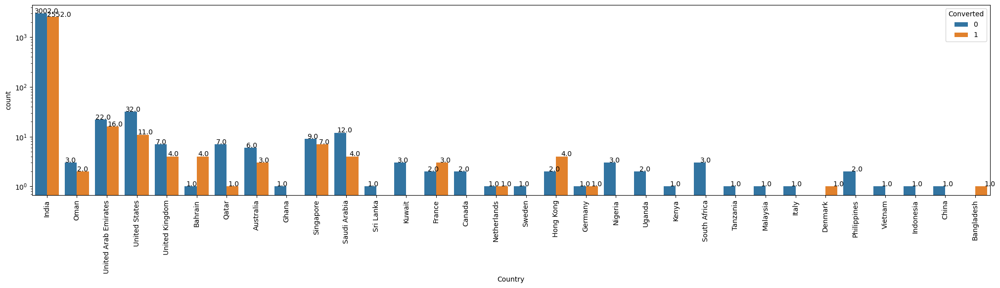

In [90]:
plt.figure(figsize = (25,5))
ax= sns.countplot(x = "Country", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Most values are 'India' , we can tell core business is coming from India market

**They have potential to make business from US, Middle East & Europe**

## Specialization

In [91]:
lead.Specialization.describe()

count       5747
unique        19
top       Others
freq        1379
Name: Specialization, dtype: object

In [92]:
lead.Specialization.value_counts()

Specialization
Others                               1379
Finance Management                    725
Marketing Management                  644
Human Resource Management             640
Operations Management                 374
Business Administration               298
Supply Chain Management               265
IT Projects Management                265
Banking, Investment And Insurance     260
Media and Advertising                 154
Travel and Tourism                    142
International Business                129
Healthcare Management                 119
Hospitality Management                 85
E-COMMERCE                             76
Retail Management                      75
Rural and Agribusiness                 56
E-Business                             39
Services Excellence                    22
Name: count, dtype: int64

In [93]:
lead['Specialization'] = lead['Specialization'].replace(['Others'], 'Other_Specialization')

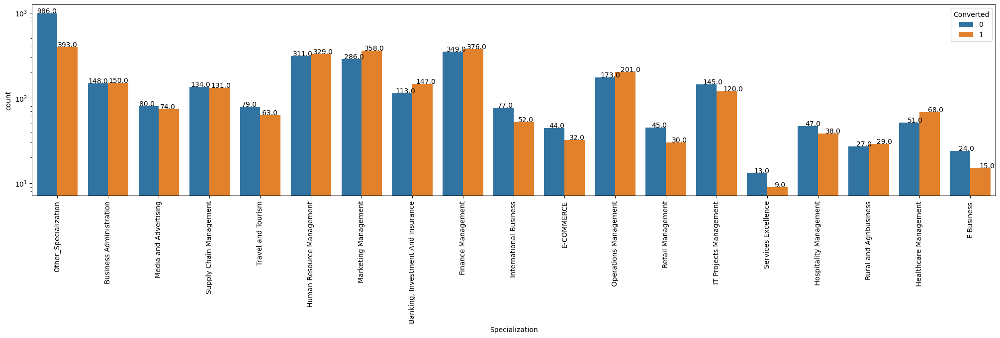

In [94]:
plt.figure(figsize = (25,5))
ax= sns.countplot(x = "Specialization", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Focus should be more on the Specialization with high conversion rate.

## Occupation

In [95]:
lead['What is your current occupation'].describe()

count           5747
unique             6
top       Unemployed
freq            4858
Name: What is your current occupation, dtype: object

In [96]:
lead['What is your current occupation'].value_counts()

What is your current occupation
Unemployed              4858
Working Professional     666
Student                  193
Other                     15
Housewife                  9
Businessman                6
Name: count, dtype: int64

In [97]:
lead['What is your current occupation'] = lead['What is your current occupation'].replace(['Other'], 'Other_Occupation')

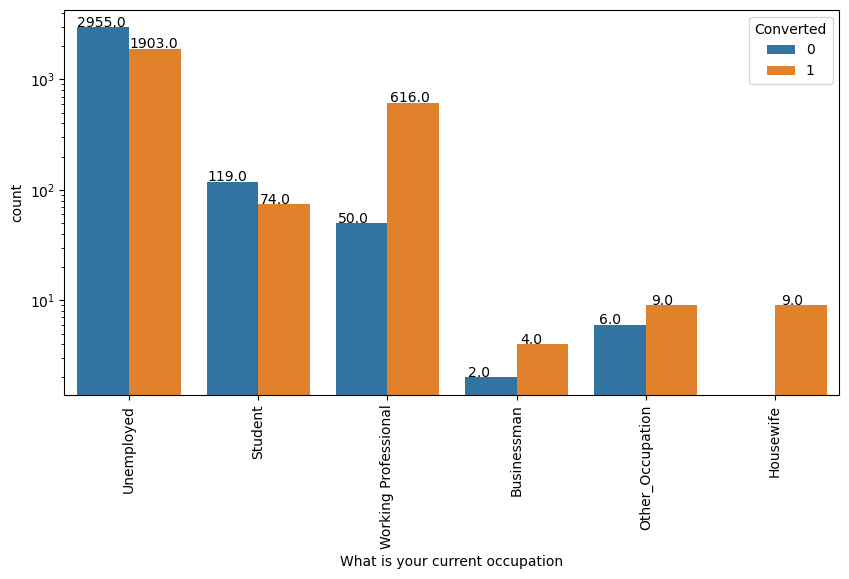

In [98]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "What is your current occupation", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Working Professionals going for the course have high chances of joining it.
- Unemployed leads are the most in numbers but has around 30-35% conversion rate.

## What matters most to you in choosing a course

In [99]:
lead['What matters most to you in choosing a course'].describe()

count                        5747
unique                          3
top       Better Career Prospects
freq                         5745
Name: What matters most to you in choosing a course, dtype: object

In [100]:
lead['What matters most to you in choosing a course'].value_counts()

What matters most to you in choosing a course
Better Career Prospects      5745
Flexibility & Convenience       1
Other                           1
Name: count, dtype: int64

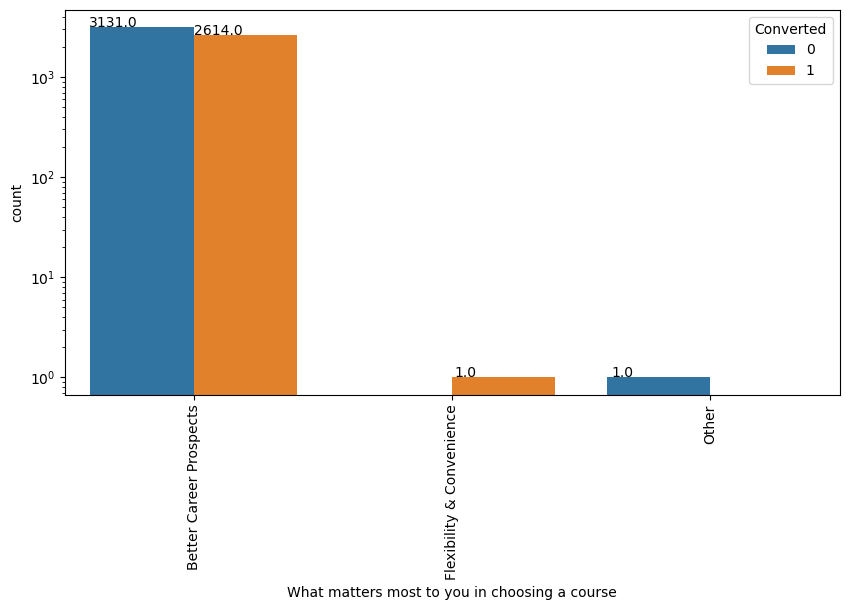

In [101]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "What matters most to you in choosing a course", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Most entries are 'Better Career Prospects'. No Inference can be drawn with this parameter.

## Search

In [102]:
lead.Search.describe()

count     5747
unique       2
top         No
freq      5737
Name: Search, dtype: object

In [103]:
lead.Search.value_counts()

Search
No     5737
Yes      10
Name: count, dtype: int64

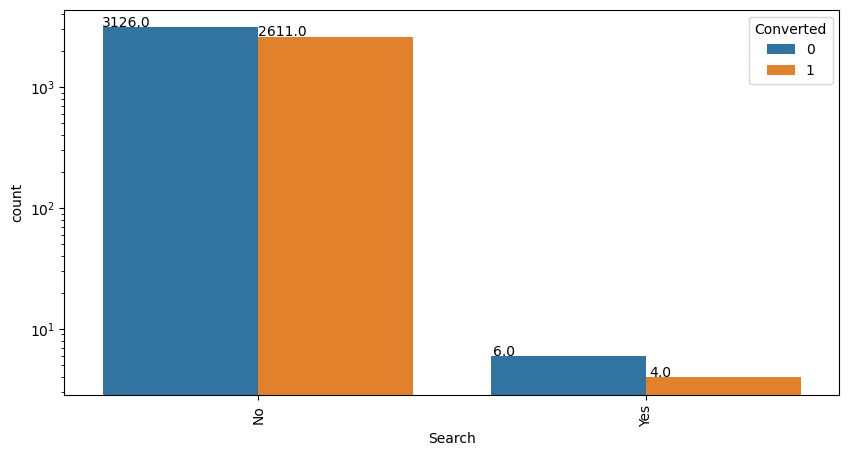

In [104]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "Search", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Most entries are 'No'. No Inference can be drawn with this parameter.

## Magazine

In [105]:
lead.Magazine.describe()

count     5747
unique       1
top         No
freq      5747
Name: Magazine, dtype: object

In [106]:
lead.Magazine.value_counts()

Magazine
No    5747
Name: count, dtype: int64

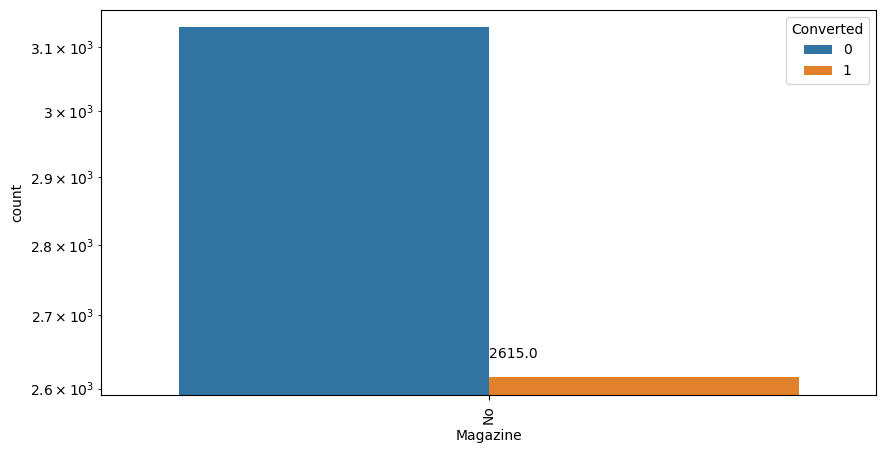

In [107]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "Magazine", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- All entries are 'No'. No Inference can be drawn with this parameter.

## Newspaper Article

In [108]:
lead['Newspaper Article'].describe()

count     5747
unique       2
top         No
freq      5746
Name: Newspaper Article, dtype: object

In [109]:
lead['Newspaper Article'].value_counts()

Newspaper Article
No     5746
Yes       1
Name: count, dtype: int64

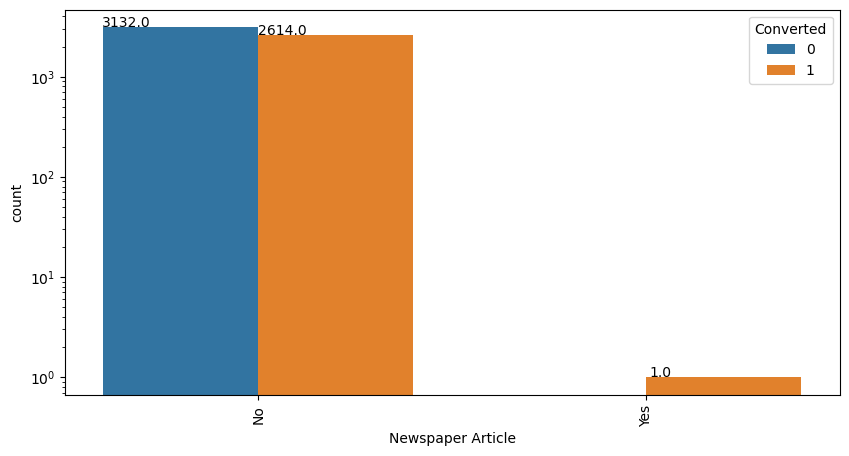

In [110]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "Newspaper Article", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Most entries are 'No'. No Inference can be drawn with this parameter.

## X Education Forums

In [111]:
lead['X Education Forums'].describe()

count     5747
unique       1
top         No
freq      5747
Name: X Education Forums, dtype: object

In [112]:
lead['X Education Forums'].value_counts()

X Education Forums
No    5747
Name: count, dtype: int64

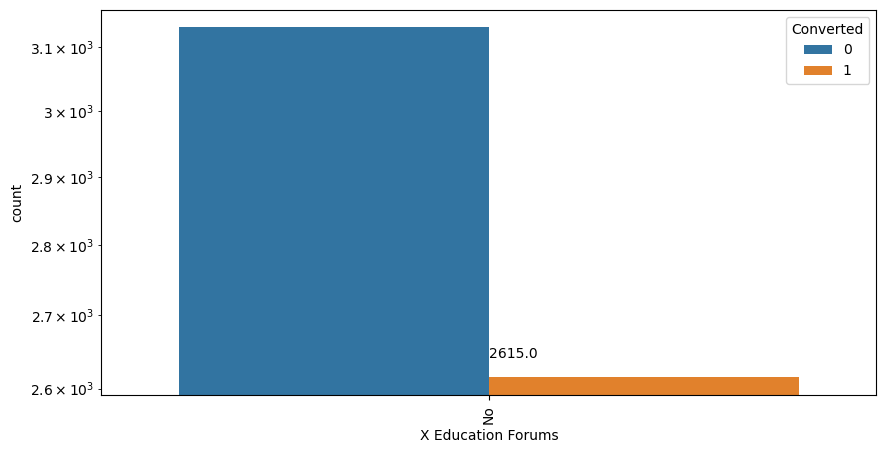

In [113]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "X Education Forums", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Most entries are 'No'. No Inference can be drawn with this parameter.

## Newspaper

In [114]:
lead['Newspaper'].describe()

count     5747
unique       2
top         No
freq      5746
Name: Newspaper, dtype: object

In [115]:
lead['Newspaper'].value_counts()

Newspaper
No     5746
Yes       1
Name: count, dtype: int64

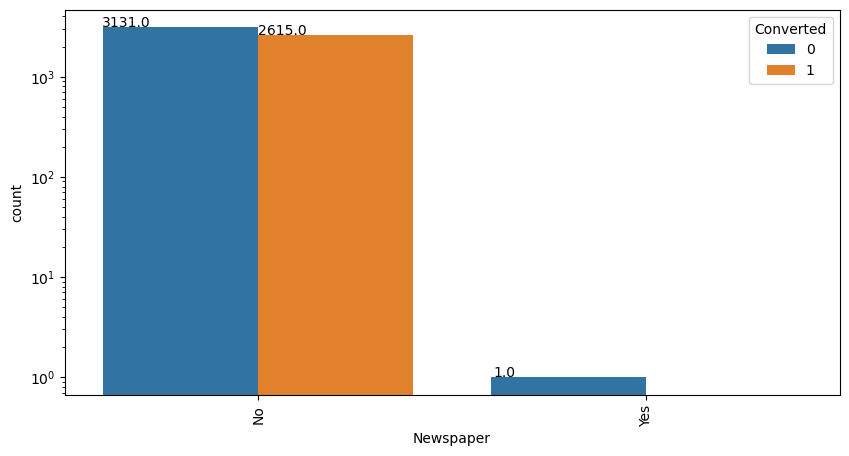

In [116]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "Newspaper", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Most entries are 'No'. No Inference can be drawn with this parameter.

## Digital Advertisement

In [117]:
lead['Digital Advertisement'].describe()

count     5747
unique       2
top         No
freq      5744
Name: Digital Advertisement, dtype: object

In [118]:
lead['Digital Advertisement'].value_counts()

Digital Advertisement
No     5744
Yes       3
Name: count, dtype: int64

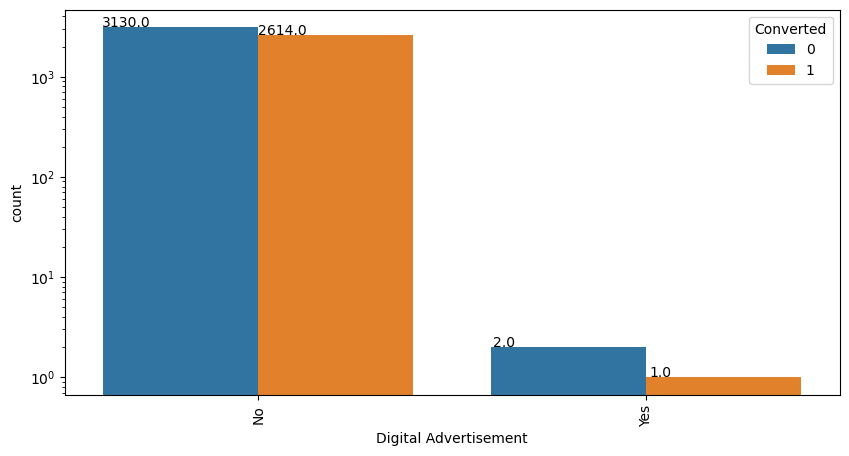

In [119]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "Digital Advertisement", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Most entries are 'No'. No Inference can be drawn with this parameter.

## Through Recommendations

In [120]:
lead['Through Recommendations'].describe()

count     5747
unique       2
top         No
freq      5741
Name: Through Recommendations, dtype: object

In [121]:
lead['Through Recommendations'].value_counts()

Through Recommendations
No     5741
Yes       6
Name: count, dtype: int64

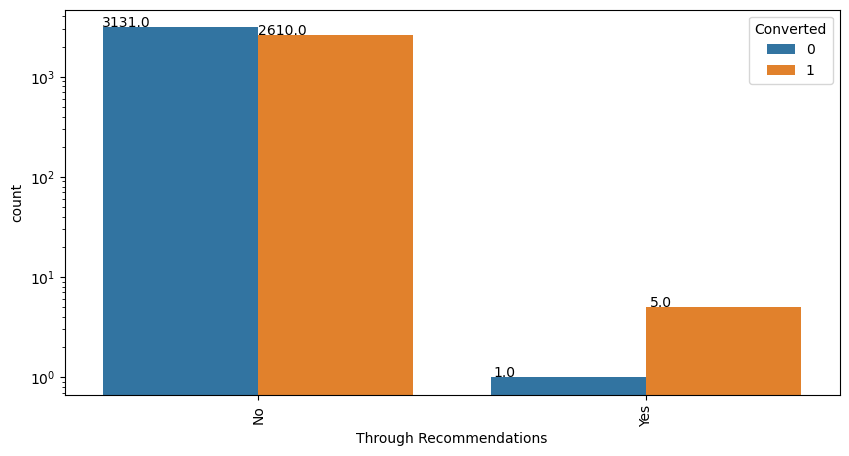

In [122]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "Through Recommendations", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Most entries are 'No'. No Inference can be drawn with this parameter.

## Receive More Updates About Our Courses

In [123]:
lead['Receive More Updates About Our Courses'].describe()

count     5747
unique       1
top         No
freq      5747
Name: Receive More Updates About Our Courses, dtype: object

In [124]:
lead['Receive More Updates About Our Courses'].value_counts()

Receive More Updates About Our Courses
No    5747
Name: count, dtype: int64

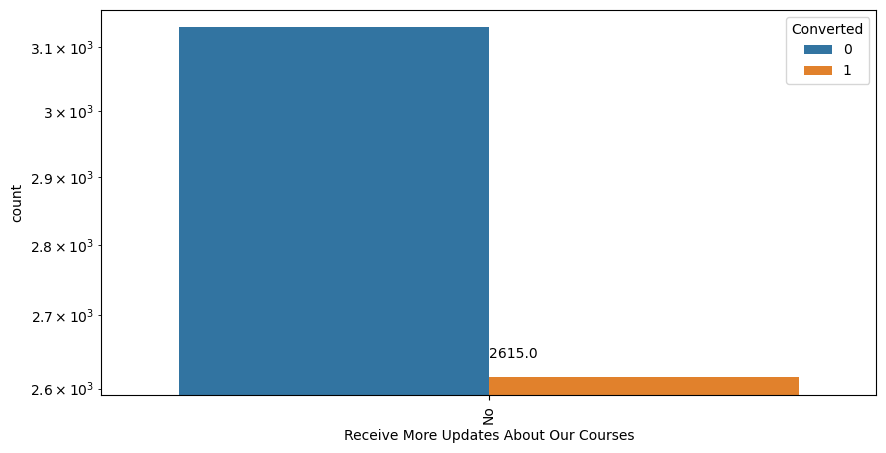

In [125]:
plt.figure(figsize = (10,5))
ax= sns.countplot(x = "Receive More Updates About Our Courses", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- All entries are 'No'. No Inference can be drawn with this parameter.

## Update me on Supply Chain Content

In [126]:
lead['Update me on Supply Chain Content'].describe()

count     5747
unique       1
top         No
freq      5747
Name: Update me on Supply Chain Content, dtype: object

In [127]:
lead['Update me on Supply Chain Content'].value_counts()

Update me on Supply Chain Content
No    5747
Name: count, dtype: int64

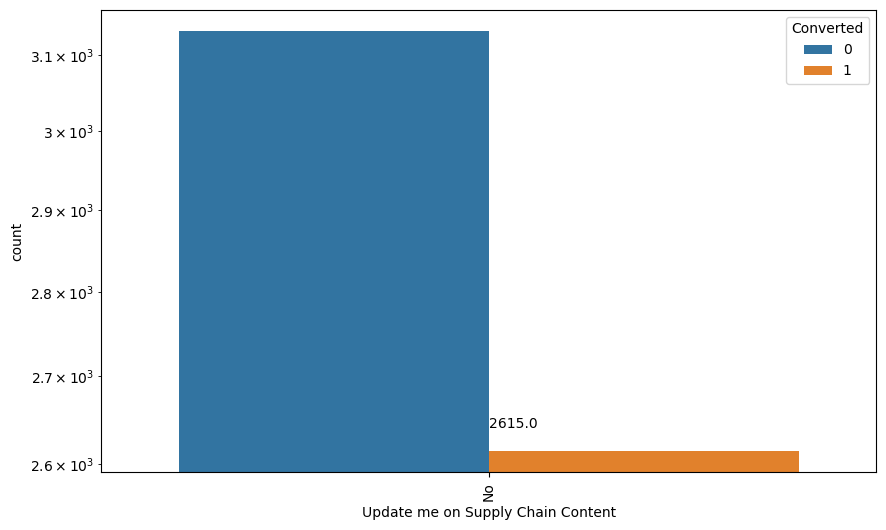

In [128]:
plt.figure(figsize = (10,6))
ax= sns.countplot(x = "Update me on Supply Chain Content", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- All entries are 'No'. No Inference can be drawn with this parameter.

## Get updates on DM Content

In [129]:
lead['Get updates on DM Content'].describe()

count     5747
unique       1
top         No
freq      5747
Name: Get updates on DM Content, dtype: object

In [130]:
lead['Get updates on DM Content'].value_counts()

Get updates on DM Content
No    5747
Name: count, dtype: int64

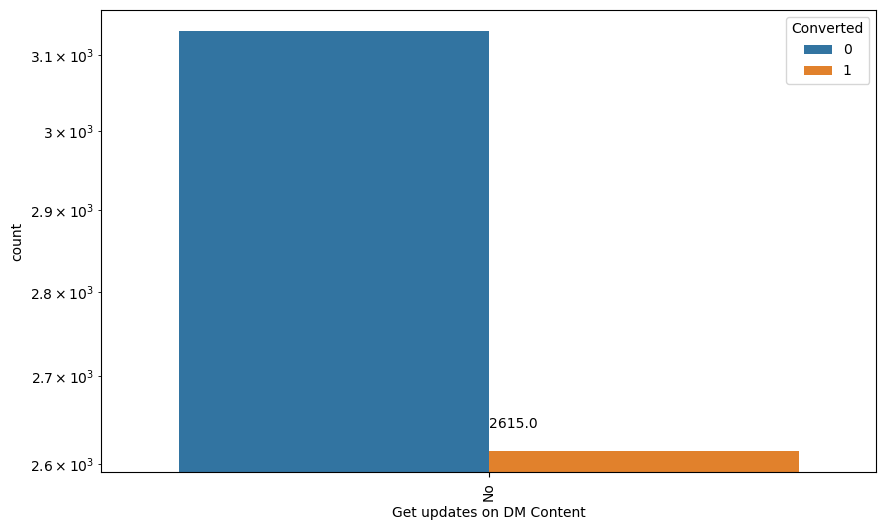

In [131]:
plt.figure(figsize = (10,6))
ax= sns.countplot(x = "Get updates on DM Content", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- All entries are 'No'. No Inference can be drawn with this parameter.

## I agree to pay the amount through cheque

In [132]:
lead['I agree to pay the amount through cheque'].describe()

count     5747
unique       1
top         No
freq      5747
Name: I agree to pay the amount through cheque, dtype: object

In [133]:
lead['I agree to pay the amount through cheque'].value_counts()

I agree to pay the amount through cheque
No    5747
Name: count, dtype: int64

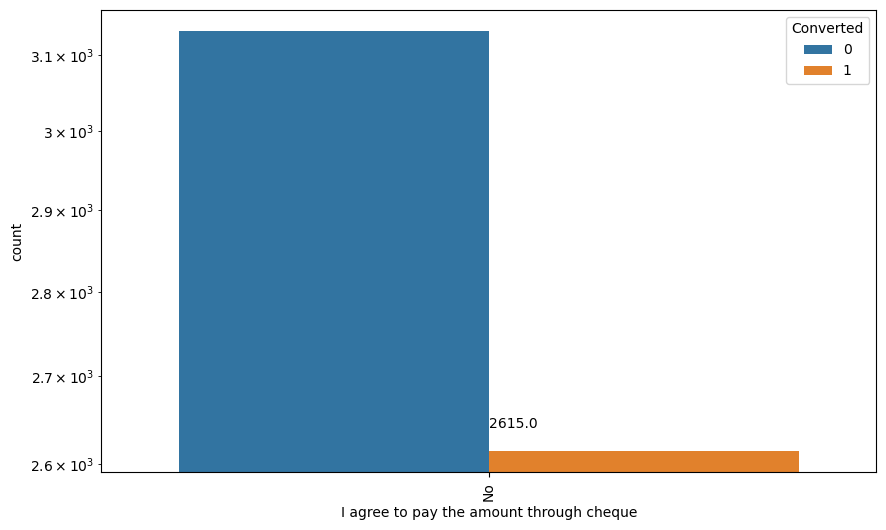

In [134]:
plt.figure(figsize = (10,6))
ax= sns.countplot(x = "I agree to pay the amount through cheque", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

All entries are 'No'. No Inference can be drawn with this parameter.

## A free copy of Mastering The Interview

In [135]:
lead['A free copy of Mastering The Interview'].describe()

count     5747
unique       2
top         No
freq      3644
Name: A free copy of Mastering The Interview, dtype: object

In [136]:
lead['A free copy of Mastering The Interview'].value_counts()

A free copy of Mastering The Interview
No     3644
Yes    2103
Name: count, dtype: int64

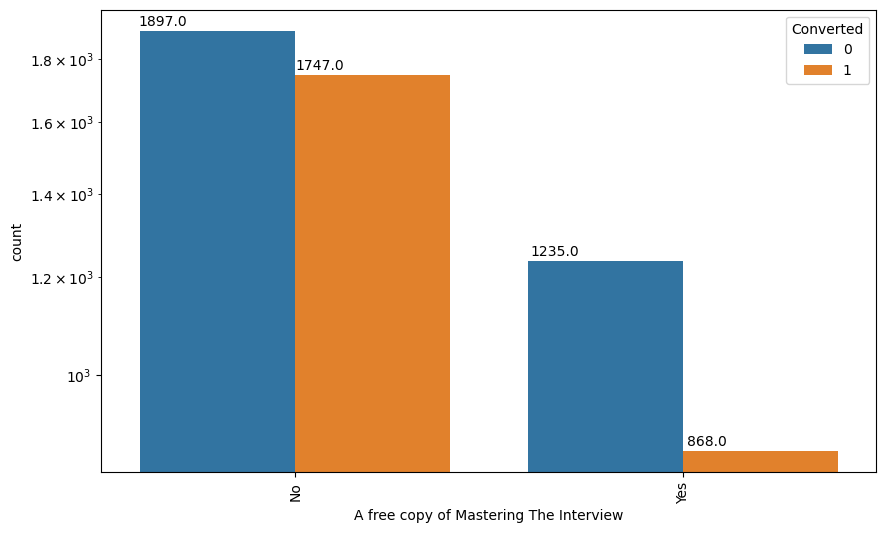

In [137]:
plt.figure(figsize = (10,6))
ax= sns.countplot(x = "A free copy of Mastering The Interview", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- 'A free copy of Mastering The Interview' doesn't play role in decision making.

## City

In [138]:
lead.City.describe()

count       5747
unique         6
top       Mumbai
freq        4034
Name: City, dtype: object

In [139]:
lead.City.value_counts()

City
Mumbai                         4034
Thane & Outskirts               568
Other Cities                    495
Other Cities of Maharashtra     320
Other Metro Cities              276
Tier II Cities                   54
Name: count, dtype: int64

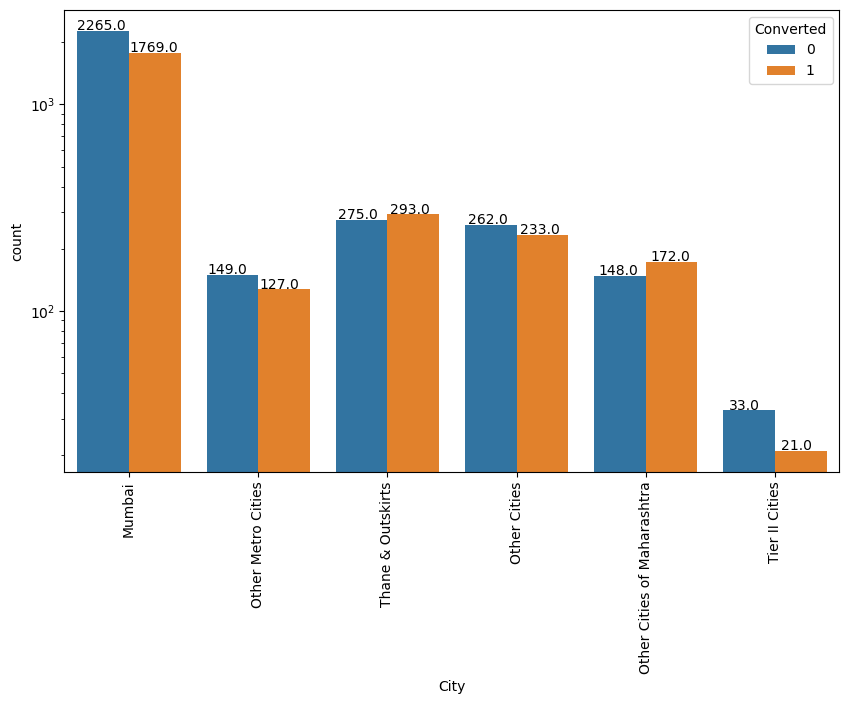

In [140]:
plt.figure(figsize = (10,6))
ax= sns.countplot(x = "City", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- Most leads are from mumbai with around 30% conversion rate.

## Last Notable Activity

In [141]:
lead['Last Notable Activity'].describe()

count         5747
unique          15
top       Modified
freq          1881
Name: Last Notable Activity, dtype: object

In [142]:
lead['Last Notable Activity'].value_counts()

Last Notable Activity
Modified                        1881
Email Opened                    1806
SMS Sent                        1597
Page Visited on Website          197
Email Link Clicked               103
Olark Chat Conversation           57
Email Bounced                     35
Unsubscribed                      30
Unreachable                       22
Had a Phone Conversation          13
Email Marked Spam                  2
Approached upfront                 1
Resubscribed to emails             1
View in browser link Clicked       1
Email Received                     1
Name: count, dtype: int64

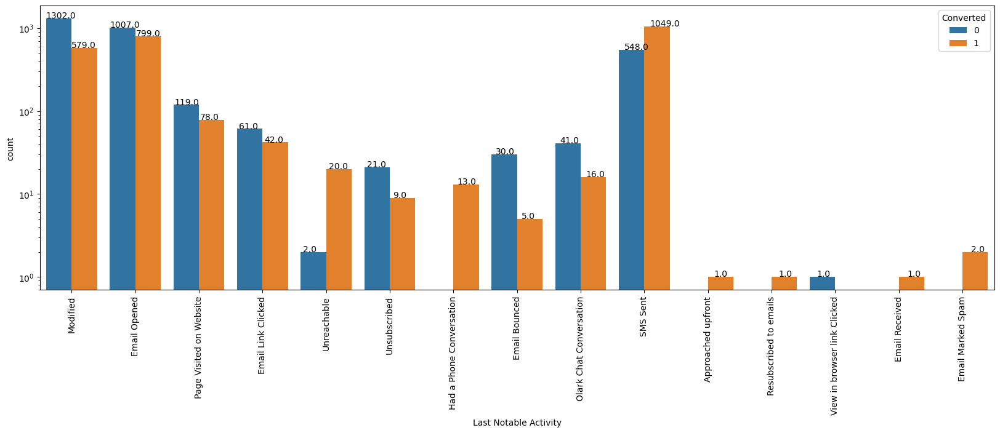

In [143]:
plt.figure(figsize = (20,6))
ax= sns.countplot(x = "Last Notable Activity", hue = "Converted", data = lead)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.xticks(rotation = 90)
ax.set_yscale('log')
plt.show()

- 'SMS Sent' is strong symbol for positive lead

## **Results**


Based on the univariate analysis we have seen that many columns are not adding any information to the model, hence we can drop them for frther analysis

In [144]:

columns_to_drop = ['What matters most to you in choosing a course','Search',
                  'Magazine','Newspaper Article','X Education Forums','Newspaper',
           'Digital Advertisement','Through Recommendations','Receive More Updates About Our Courses',
                  'Update me on Supply Chain Content',
           'Get updates on DM Content','I agree to pay the amount through cheque',
                  'A free copy of Mastering The Interview','Country','Tags']

# Drop only the columns that still exist in the DataFrame
lead = lead.drop(columns=[col for col in columns_to_drop if col in lead.columns], errors='ignore')

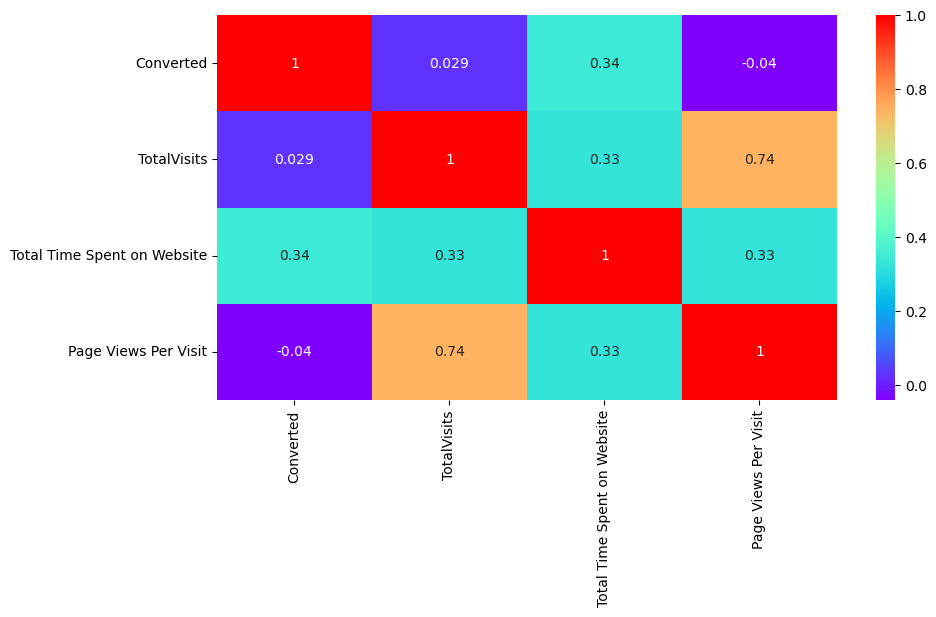

In [145]:
# Let's check the correlation coefficients to see which variables are highly correlated
# Convert to numeric before calculating correlations

# Assuming 'lead' DataFrame
numeric_lead = lead.apply(pd.to_numeric, errors='ignore')  # Convert to numeric if possible, ignore errors

plt.figure(figsize=(10, 5))
sns.heatmap(numeric_lead.select_dtypes(include=np.number).corr(),
            annot=True, cmap="rainbow")
plt.show()

- Total Visits & Page Views per Vist are higly correlated with correlation of .77

In [146]:
print(lead['Last Activity'].value_counts())
print(lead['Last Notable Activity'].value_counts())

Last Activity
Email Opened                 2221
SMS Sent                     1902
Page Visited on Website       410
Olark Chat Conversation       376
Converted to Lead             289
Email Link Clicked            168
Email Bounced                 155
Form Submitted on Website      79
Unreachable                    70
Unsubscribed                   40
Other_Activity                 37
Name: count, dtype: int64
Last Notable Activity
Modified                        1881
Email Opened                    1806
SMS Sent                        1597
Page Visited on Website          197
Email Link Clicked               103
Olark Chat Conversation           57
Email Bounced                     35
Unsubscribed                      30
Unreachable                       22
Had a Phone Conversation          13
Email Marked Spam                  2
Approached upfront                 1
Resubscribed to emails             1
View in browser link Clicked       1
Email Received                     1
Name: cou

In [147]:
#Values under 'Last Activity' are coverved as values under 'Last Notable Activity'. Either of one can be dropped.
lead.drop(columns=['Last Notable Activity'], inplace = True) # Changed the '1' to 'columns='

In [148]:
print("Original Columns {} % Retained".format(round((100* len(lead.columns)/len(lead_dub.columns)),2)))

Original Columns 32.43 % Retained


In [149]:
print("Original Rows {} % Retained".format(round((len(lead)*100)/len(lead_dub),2)))


Original Rows 62.2 % Retained


In [150]:
print("Original Data {} % Retained".format(round((len(lead) *
                                                     len(lead.columns))*100/(len(lead_dub.columns)*len(lead_dub)),2)))

Original Data 20.17 % Retained


In [151]:
lead.shape

(5747, 12)

In [152]:
lead.head()

,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Last Activity,Specialization,What is your current occupation,City
0,API,Olark Chat,No,No,0,0.0,0,0.0,Page Visited on Website,Other_Specialization,Unemployed,Mumbai
1,API,Organic Search,No,No,0,5.0,674,2.5,Email Opened,Other_Specialization,Unemployed,Mumbai
2,Landing Page Submission,Direct Traffic,No,No,1,2.0,1532,2.0,Email Opened,Business Administration,Student,Mumbai
3,Landing Page Submission,Direct Traffic,No,No,0,1.0,305,1.0,Unreachable,Media and Advertising,Unemployed,Mumbai
4,Landing Page Submission,Google,No,No,1,2.0,1428,1.0,Converted to Lead,Other_Specialization,Unemployed,Mumbai


## Data Preparation

### Converting some binary variables (Yes/No) to 1/0

In [153]:
# List of variables to map

varlist =  ['Do Not Email', 'Do Not Call']

# Defining the map function
def binary_map(x):
    return x.map({'Yes': 1, "No": 0})

# Applying the function to the housing list
lead[varlist] = lead[varlist].apply(binary_map)
lead.head()

,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Last Activity,Specialization,What is your current occupation,City
0,API,Olark Chat,0,0,0,0.0,0,0.0,Page Visited on Website,Other_Specialization,Unemployed,Mumbai
1,API,Organic Search,0,0,0,5.0,674,2.5,Email Opened,Other_Specialization,Unemployed,Mumbai
2,Landing Page Submission,Direct Traffic,0,0,1,2.0,1532,2.0,Email Opened,Business Administration,Student,Mumbai
3,Landing Page Submission,Direct Traffic,0,0,0,1.0,305,1.0,Unreachable,Media and Advertising,Unemployed,Mumbai
4,Landing Page Submission,Google,0,0,1,2.0,1428,1.0,Converted to Lead,Other_Specialization,Unemployed,Mumbai


# Creating Dummy vairables

In [154]:
# Create dummy variables using the 'get_dummies'
dummy = pd.get_dummies(lead[['Lead Origin','Specialization' ,'Lead Source', 'Last Activity', 'What is your current occupation']], drop_first=True)
# Add the results to the master dataframe
Lead_dum = pd.concat([lead, dummy.astype(int)], axis=1)
Lead_dum

,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Last Activity,Specialization,What is your current occupation,City,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Lead Origin_Lead Import,Specialization_Business Administration,Specialization_E-Business,Specialization_E-COMMERCE,Specialization_Finance Management,Specialization_Healthcare Management,Specialization_Hospitality Management,Specialization_Human Resource Management,Specialization_IT Projects Management,Specialization_International Business,Specialization_Marketing Management,Specialization_Media and Advertising,Specialization_Operations Management,Specialization_Other_Specialization,Specialization_Retail Management,Specialization_Rural and Agribusiness,Specialization_Services Excellence,Specialization_Supply Chain Management,Specialization_Travel and Tourism,Lead Source_Facebook,Lead Source_Google,Lead Source_Olark Chat,Lead Source_Organic Search,Lead Source_Others,Lead Source_Reference,Lead Source_Referral Sites,Lead Source_Welingak Website,Last Activity_Email Bounced,Last Activity_Email Link Clicked,Last Activity_Email Opened,Last Activity_Form Submitted on Website,Last Activity_Olark Chat Conversation,Last Activity_Other_Activity,Last Activity_Page Visited on Website,Last Activity_SMS Sent,Last Activity_Unreachable,Last Activity_Unsubscribed,What is your current occupation_Housewife,What is your current occupation_Other_Occupation,What is your current occupation_Student,What is your current occupation_Unemployed,What is your current occupation_Working Professional
0,API,Olark Chat,0,0,0,0.0,0,0.00,Page Visited on Website,Other_Specialization,Unemployed,Mumbai,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
1,API,Organic Search,0,0,0,5.0,674,2.50,Email Opened,Other_Specialization,Unemployed,Mumbai,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
2,Landing Page Submission,Direct Traffic,0,0,1,2.0,1532,2.00,Email Opened,Business Administration,Student,Mumbai,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
3,Landing Page Submission,Direct Traffic,0,0,0,1.0,305,1.00,Unreachable,Media and Advertising,Unemployed,Mumbai,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
4,Landing Page Submission,Google,0,0,1,2.0,1428,1.00,Converted to Lead,Other_Specialization,Unemployed,Mumbai,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
6,Landing Page Submission,Google,0,0,1,2.0,1640,2.00,Email Opened,Supply Chain Management,Unemployed,Mumbai,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
10,Landing Page Submission,Organic Search,0,0,1,8.0,1351,6.00,Email Opened,Travel and Tourism,Unemployed,Other Metro Cities,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
11,Landing Page Submission,Direct Traffic,0,0,1,8.0,1343,2.67,Page Visited on Website,Human Resource Management,Unemployed,Thane & Outskirts,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
12,API,Organic Search,0,0,1,10.0,1538,6.00,Email Opened,Marketing Management,Unemployed,Mumbai,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
13,Landing Page Submission,Organic Search,0,0,0,5.0,170,5.00,Email Opened,Business Administration,Unemployed,Thane & Outskirts,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0


In [155]:
Lead_dum = Lead_dum.drop(['Lead Origin', 'Lead Source', 'Last Activity', 'Specialization',
                  'What is your current occupation','City'], axis = 1)

Lead_dum.head()

,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Lead Origin_Lead Import,Specialization_Business Administration,Specialization_E-Business,Specialization_E-COMMERCE,Specialization_Finance Management,Specialization_Healthcare Management,Specialization_Hospitality Management,Specialization_Human Resource Management,Specialization_IT Projects Management,Specialization_International Business,Specialization_Marketing Management,Specialization_Media and Advertising,Specialization_Operations Management,Specialization_Other_Specialization,Specialization_Retail Management,Specialization_Rural and Agribusiness,Specialization_Services Excellence,Specialization_Supply Chain Management,Specialization_Travel and Tourism,Lead Source_Facebook,Lead Source_Google,Lead Source_Olark Chat,Lead Source_Organic Search,Lead Source_Others,Lead Source_Reference,Lead Source_Referral Sites,Lead Source_Welingak Website,Last Activity_Email Bounced,Last Activity_Email Link Clicked,Last Activity_Email Opened,Last Activity_Form Submitted on Website,Last Activity_Olark Chat Conversation,Last Activity_Other_Activity,Last Activity_Page Visited on Website,Last Activity_SMS Sent,Last Activity_Unreachable,Last Activity_Unsubscribed,What is your current occupation_Housewife,What is your current occupation_Other_Occupation,What is your current occupation_Student,What is your current occupation_Unemployed,What is your current occupation_Working Professional
0,0,0,0,0.0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
1,0,0,0,5.0,674,2.5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
2,0,0,1,2.0,1532,2.0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
3,0,0,0,1.0,305,1.0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
4,0,0,1,2.0,1428,1.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [156]:
Lead_dum.shape

(5747, 50)

# Test-Train Split

In [199]:
from sklearn.model_selection import train_test_split

# Import MinMax scaler
from sklearn.preprocessing import MinMaxScaler
# Importing metrics from sklearn for evaluation
from sklearn import metrics

In [158]:
X = Lead_dum.drop(['Converted'], axis=1)
Y = Lead_dum['Converted']

In [159]:
X.head()

,Do Not Email,Do Not Call,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Lead Origin_Lead Import,Specialization_Business Administration,Specialization_E-Business,Specialization_E-COMMERCE,Specialization_Finance Management,Specialization_Healthcare Management,Specialization_Hospitality Management,Specialization_Human Resource Management,Specialization_IT Projects Management,Specialization_International Business,Specialization_Marketing Management,Specialization_Media and Advertising,Specialization_Operations Management,Specialization_Other_Specialization,Specialization_Retail Management,Specialization_Rural and Agribusiness,Specialization_Services Excellence,Specialization_Supply Chain Management,Specialization_Travel and Tourism,Lead Source_Facebook,Lead Source_Google,Lead Source_Olark Chat,Lead Source_Organic Search,Lead Source_Others,Lead Source_Reference,Lead Source_Referral Sites,Lead Source_Welingak Website,Last Activity_Email Bounced,Last Activity_Email Link Clicked,Last Activity_Email Opened,Last Activity_Form Submitted on Website,Last Activity_Olark Chat Conversation,Last Activity_Other_Activity,Last Activity_Page Visited on Website,Last Activity_SMS Sent,Last Activity_Unreachable,Last Activity_Unsubscribed,What is your current occupation_Housewife,What is your current occupation_Other_Occupation,What is your current occupation_Student,What is your current occupation_Unemployed,What is your current occupation_Working Professional
0,0,0,0.0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
1,0,0,5.0,674,2.5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
2,0,0,2.0,1532,2.0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
3,0,0,1.0,305,1.0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
4,0,0,2.0,1428,1.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [160]:
X.shape

(5747, 49)

In [161]:
Y.head()

0    0
1    0
2    1
3    0
4    1
Name: Converted, dtype: int64

In [162]:
# Split the dataset into 70% and 30% for train and test respectively
X_train, X_test, y_train, y_test = train_test_split(X, Y, train_size=0.7, test_size=0.3, random_state=40)

In [163]:
X_train.head()

,Do Not Email,Do Not Call,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Lead Origin_Lead Import,Specialization_Business Administration,Specialization_E-Business,Specialization_E-COMMERCE,Specialization_Finance Management,Specialization_Healthcare Management,Specialization_Hospitality Management,Specialization_Human Resource Management,Specialization_IT Projects Management,Specialization_International Business,Specialization_Marketing Management,Specialization_Media and Advertising,Specialization_Operations Management,Specialization_Other_Specialization,Specialization_Retail Management,Specialization_Rural and Agribusiness,Specialization_Services Excellence,Specialization_Supply Chain Management,Specialization_Travel and Tourism,Lead Source_Facebook,Lead Source_Google,Lead Source_Olark Chat,Lead Source_Organic Search,Lead Source_Others,Lead Source_Reference,Lead Source_Referral Sites,Lead Source_Welingak Website,Last Activity_Email Bounced,Last Activity_Email Link Clicked,Last Activity_Email Opened,Last Activity_Form Submitted on Website,Last Activity_Olark Chat Conversation,Last Activity_Other_Activity,Last Activity_Page Visited on Website,Last Activity_SMS Sent,Last Activity_Unreachable,Last Activity_Unsubscribed,What is your current occupation_Housewife,What is your current occupation_Other_Occupation,What is your current occupation_Student,What is your current occupation_Unemployed,What is your current occupation_Working Professional
5158,0,0,2.0,1325,2.0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
2060,0,0,3.0,1087,1.5,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
1943,0,0,2.0,1419,2.0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
2689,0,0,5.0,23,5.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
4844,0,0,4.0,1502,2.0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1


In [164]:
X_train.shape

(4022, 49)

In [165]:
X_test.head()

,Do Not Email,Do Not Call,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Lead Origin_Lead Import,Specialization_Business Administration,Specialization_E-Business,Specialization_E-COMMERCE,Specialization_Finance Management,Specialization_Healthcare Management,Specialization_Hospitality Management,Specialization_Human Resource Management,Specialization_IT Projects Management,Specialization_International Business,Specialization_Marketing Management,Specialization_Media and Advertising,Specialization_Operations Management,Specialization_Other_Specialization,Specialization_Retail Management,Specialization_Rural and Agribusiness,Specialization_Services Excellence,Specialization_Supply Chain Management,Specialization_Travel and Tourism,Lead Source_Facebook,Lead Source_Google,Lead Source_Olark Chat,Lead Source_Organic Search,Lead Source_Others,Lead Source_Reference,Lead Source_Referral Sites,Lead Source_Welingak Website,Last Activity_Email Bounced,Last Activity_Email Link Clicked,Last Activity_Email Opened,Last Activity_Form Submitted on Website,Last Activity_Olark Chat Conversation,Last Activity_Other_Activity,Last Activity_Page Visited on Website,Last Activity_SMS Sent,Last Activity_Unreachable,Last Activity_Unsubscribed,What is your current occupation_Housewife,What is your current occupation_Other_Occupation,What is your current occupation_Student,What is your current occupation_Unemployed,What is your current occupation_Working Professional
7656,1,0,6.0,352,6.0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
3149,0,0,2.0,245,2.0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
7878,0,0,2.0,1087,2.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
1490,0,0,5.0,1513,5.0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1
1189,0,0,5.0,1492,5.0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0


In [166]:
X_test.shape

(1725, 49)

In [167]:
y_train.head()

5158    1
2060    1
1943    0
2689    1
4844    1
Name: Converted, dtype: int64

In [168]:
y_test.head()

7656    0
3149    1
7878    0
1490    1
1189    1
Name: Converted, dtype: int64

# Feature Scaling

In [169]:
# Scale the three numeric features
scaler = MinMaxScaler()
X_train[['TotalVisits', 'Page Views Per Visit', 'Total Time Spent on Website']] = scaler.fit_transform(X_train[['TotalVisits', 'Page Views Per Visit', 'Total Time Spent on Website']])
X_train.head()

,Do Not Email,Do Not Call,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Lead Origin_Lead Import,Specialization_Business Administration,Specialization_E-Business,Specialization_E-COMMERCE,Specialization_Finance Management,Specialization_Healthcare Management,Specialization_Hospitality Management,Specialization_Human Resource Management,Specialization_IT Projects Management,Specialization_International Business,Specialization_Marketing Management,Specialization_Media and Advertising,Specialization_Operations Management,Specialization_Other_Specialization,Specialization_Retail Management,Specialization_Rural and Agribusiness,Specialization_Services Excellence,Specialization_Supply Chain Management,Specialization_Travel and Tourism,Lead Source_Facebook,Lead Source_Google,Lead Source_Olark Chat,Lead Source_Organic Search,Lead Source_Others,Lead Source_Reference,Lead Source_Referral Sites,Lead Source_Welingak Website,Last Activity_Email Bounced,Last Activity_Email Link Clicked,Last Activity_Email Opened,Last Activity_Form Submitted on Website,Last Activity_Olark Chat Conversation,Last Activity_Other_Activity,Last Activity_Page Visited on Website,Last Activity_SMS Sent,Last Activity_Unreachable,Last Activity_Unsubscribed,What is your current occupation_Housewife,What is your current occupation_Other_Occupation,What is your current occupation_Student,What is your current occupation_Unemployed,What is your current occupation_Working Professional
5158,0,0,0.2,0.583187,0.333333,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
2060,0,0,0.3,0.478433,0.250000,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
1943,0,0,0.2,0.624560,0.333333,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
2689,0,0,0.5,0.010123,0.833333,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
4844,0,0,0.4,0.661092,0.333333,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1


In [170]:
# Checking the Converted Rate
Converted = round((sum(Lead_dum['Converted'])/len(Lead_dum['Converted'].index))*100,2)
print("We have almost {} %  Converted rate after successful data manipulation".format(Converted))

We have almost 45.5 %  Converted rate after successful data manipulation


# Model Building

In [171]:
# Import 'LogisticRegression'
from sklearn.linear_model import LogisticRegression
import statsmodels.api as sm
# Import RFE
from sklearn.feature_selection import RFE

# Importing 'variance_inflation_factor'
from statsmodels.stats.outliers_influence import variance_inflation_factor

#### Running Your First Training Model

In [172]:
logm1 = sm.GLM(y_train,(sm.add_constant(X_train)), family = sm.families.Binomial())
logm1.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 4022
Model:                            GLM   Df Residuals:                     3972
Model Family:                Binomial   Df Model:                           49
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1727.7
Date:                Sun, 19 Jan 2025   Deviance:                       3455.3
Time:                        00:20:04   Pearson chi2:                 4.33e+03
No. Iterations:                    22   Pseudo R-squ. (CS):             0.4072
Covariance Type:            nonrobust                                         
========================================================================================================================
                                                           coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------------
const                                                   -3.0925      1.957     -1.580      0.114      -6.927       0.743
Do Not Email                                            -1.4655      0.267     -5.484      0.000      -1.989      -0.942
Do Not Call                                             21.9508   5.06e+04      0.000      1.000   -9.91e+04    9.92e+04
TotalVisits                                              1.4952      0.242      6.182      0.000       1.021       1.969
Total Time Spent on Website                              4.5619      0.203     22.424      0.000       4.163       4.961
Page Views Per Visit                                    -1.1272      0.250     -4.501      0.000      -1.618      -0.636
Lead Origin_Landing Page Submission                     -0.5536      0.158     -3.514      0.000      -0.862      -0.245
Lead Origin_Lead Add Form                                2.8094      1.446      1.942      0.052      -0.026       5.644
Lead Origin_Lead Import                                 22.6650   7.95e+04      0.000      1.000   -1.56e+05    1.56e+05
Specialization_Business Administration                  -0.2116      0.273     -0.775      0.438      -0.747       0.323
Specialization_E-Business                                0.2605      0.527      0.494      0.621      -0.773       1.294
Specialization_E-COMMERCE                                0.1255      0.424      0.296      0.767      -0.706       0.957
Specialization_Finance Management                       -0.0148      0.233     -0.064      0.949      -0.471       0.442
Specialization_Healthcare Management                    -0.0828      0.353     -0.234      0.815      -0.775       0.610
Specialization_Hospitality Management                   -0.7741      0.399     -1.940      0.052      -1.556       0.008
Specialization_Human Resource Management                -0.0880      0.237     -0.371      0.711      -0.553       0.377
Specialization_IT Projects Management                    0.1081      0.281      0.385      0.700      -0.442       0.658
Specialization_International Business                    0.0373      0.330      0.113      0.910      -0.610       0.685
Specialization_Marketing Management                      0.1293      0.237      0.545      0.586      -0.336       0.594
Specialization_Media and Advertising                    -0.4449      0.345     -1.291      0.197      -1.120       0.231
Specialization_Operations Management                     0.0677      0.263      0.257      0.797      -0.448       0.583
Specialization_Other_Specialization                     -1.2519      0.245     -5.106      0.000      -1.733      -0.771
Specialization_Retail Management                        -0

# Feature Selection Using RFE

In [173]:
lr = LogisticRegression()

# Running RFE with 18 variables as output
rfe = RFE(estimator=lr, n_features_to_select=18)
rfe = rfe.fit(X_train, y_train)

In [174]:
rfe.support_

array([ True, False,  True,  True,  True,  True,  True, False, False,
       False, False, False, False,  True, False, False, False, False,
       False, False,  True,  True, False, False, False, False, False,
       False,  True, False, False,  True, False,  True, False, False,
       False, False,  True,  True, False,  True, False,  True,  True,
       False, False, False,  True])

In [175]:
# Features that have been selected by RFE
list(zip(X_train.columns, rfe.support_, rfe.ranking_))

[('Do Not Email', True, 1),
 ('Do Not Call', False, 16),
 ('TotalVisits', True, 1),
 ('Total Time Spent on Website', True, 1),
 ('Page Views Per Visit', True, 1),
 ('Lead Origin_Landing Page Submission', True, 1),
 ('Lead Origin_Lead Add Form', True, 1),
 ('Lead Origin_Lead Import', False, 13),
 ('Specialization_Business Administration', False, 12),
 ('Specialization_E-Business', False, 15),
 ('Specialization_E-COMMERCE', False, 21),
 ('Specialization_Finance Management', False, 27),
 ('Specialization_Healthcare Management', False, 32),
 ('Specialization_Hospitality Management', True, 1),
 ('Specialization_Human Resource Management', False, 31),
 ('Specialization_IT Projects Management', False, 22),
 ('Specialization_International Business', False, 26),
 ('Specialization_Marketing Management', False, 20),
 ('Specialization_Media and Advertising', False, 8),
 ('Specialization_Operations Management', False, 24),
 ('Specialization_Other_Specialization', True, 1),
 ('Specialization_Retail 

In [176]:
# Put all the columns selected by RFE in the variable 'col'
col = X_train.columns[rfe.support_]

In [177]:
# Selecting columns selected by RFE
X_train = X_train[col]

### Training second model

In [178]:
X_train_sm = sm.add_constant(X_train)
logm2 = sm.GLM(y_train, X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 4022
Model:                            GLM   Df Residuals:                     4003
Model Family:                Binomial   Df Model:                           18
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1755.6
Date:                Sun, 19 Jan 2025   Deviance:                       3511.3
Time:                        00:20:05   Pearson chi2:                 4.39e+03
No. Iterations:                    22   Pseudo R-squ. (CS):             0.3989
Covariance Type:            nonrobust                                         
========================================================================================================================
                                                           coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------------
const                                                   -1.5221      0.177     -8.598      0.000      -1.869      -1.175
Do Not Email                                            -1.5879      0.223     -7.110      0.000      -2.026      -1.150
TotalVisits                                              1.3909      0.227      6.135      0.000       0.947       1.835
Total Time Spent on Website                              4.5391      0.199     22.771      0.000       4.148       4.930
Page Views Per Visit                                    -0.8114      0.236     -3.434      0.001      -1.275      -0.348
Lead Origin_Landing Page Submission                     -0.7396      0.145     -5.108      0.000      -1.023      -0.456
Lead Origin_Lead Add Form                                2.9923      1.117      2.679      0.007       0.803       5.182
Specialization_Hospitality Management                   -0.7231      0.342     -2.114      0.035      -1.393      -0.053
Specialization_Other_Specialization                     -1.2517      0.147     -8.509      0.000      -1.540      -0.963
Specialization_Retail Management                        -0.7789      0.370     -2.105      0.035      -1.504      -0.054
Lead Source_Olark Chat                                   1.4055      0.186      7.573      0.000       1.042       1.769
Lead Source_Reference                                    0.8611      1.133      0.760      0.447      -1.359       3.082
Lead Source_Welingak Website                            22.3353   1.56e+04      0.001      0.999   -3.06e+04    3.07e+04
Last Activity_Olark Chat Conversation                   -1.2356      0.228     -5.408      0.000      -1.683      -0.788
Last Activity_Other_Activity                             2.0025      0.659      3.037      0.002       0.710       3.295
Last Activity_SMS Sent                                   1.1789      0.092     12.834      0.000       0.999       1.359
Last Activity_Unsubscribed                               0.8638      0.655      1.319      0.187      -0.420       2.147
What is your current occupation_Housewife               23.5616    2.5e+04      0.001      0.999    -4.9e+04     4.9e+04
What is your current occupation_Working Professional     2.4925      0.202     12.369      0.000       2.098       2.888
========================================================================================================================
"""

In [179]:
# Make a VIF dataframe for all the variables present
vif = pd.DataFrame()
vif['Features'] = X_train.columns
vif['VIF'] = [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
5,Lead Origin_Lead Add Form,50.97
10,Lead Source_Reference,48.06
3,Page Views Per Visit,7.74
1,TotalVisits,5.90
11,Lead Source_Welingak Website,4.01
4,Lead Origin_Landing Page Submission,3.87
2,Total Time Spent on Website,2.28
7,Specialization_Other_Specialization,1.84
14,Last Activity_SMS Sent,1.62
9,Lead Source_Olark Chat,1.58


##### The VIF values seem fine but some p-values are 99 %. So removing ' What is your current occupation_Housewife','Lead Source_Welingak Website'

In [180]:
X_train.drop(['What is your current occupation_Housewife', 'Lead Source_Welingak Website'], axis = 1, inplace = True)

In [181]:
# Refit the model with the new set of features
X_train_sm = sm.add_constant(X_train)
logm3 = sm.GLM(y_train, X_train_sm, family = sm.families.Binomial())
res = logm3.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 4022
Model:                            GLM   Df Residuals:                     4005
Model Family:                Binomial   Df Model:                           16
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1761.5
Date:                Sun, 19 Jan 2025   Deviance:                       3523.1
Time:                        00:21:42   Pearson chi2:                 4.43e+03
No. Iterations:                     6   Pseudo R-squ. (CS):             0.3971
Covariance Type:            nonrobust                                         
========================================================================================================================
                                                           coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------------
const                                                   -1.5138      0.177     -8.562      0.000      -1.860      -1.167
Do Not Email                                            -1.5912      0.223     -7.128      0.000      -2.029      -1.154
TotalVisits                                              1.3860      0.226      6.120      0.000       0.942       1.830
Total Time Spent on Website                              4.5356      0.199     22.787      0.000       4.145       4.926
Page Views Per Visit                                    -0.8194      0.236     -3.471      0.001      -1.282      -0.357
Lead Origin_Landing Page Submission                     -0.7326      0.145     -5.067      0.000      -1.016      -0.449
Lead Origin_Lead Add Form                                5.0913      1.041      4.889      0.000       3.050       7.132
Specialization_Hospitality Management                   -0.7263      0.342     -2.124      0.034      -1.396      -0.056
Specialization_Other_Specialization                     -1.2480      0.147     -8.492      0.000      -1.536      -0.960
Specialization_Retail Management                        -0.7822      0.370     -2.115      0.034      -1.507      -0.057
Lead Source_Olark Chat                                   1.3984      0.185      7.543      0.000       1.035       1.762
Lead Source_Reference                                   -1.2307      1.059     -1.162      0.245      -3.307       0.845
Last Activity_Olark Chat Conversation                   -1.2398      0.228     -5.429      0.000      -1.687      -0.792
Last Activity_Other_Activity                             1.9966      0.659      3.028      0.002       0.704       3.289
Last Activity_SMS Sent                                   1.1713      0.092     12.767      0.000       0.992       1.351
Last Activity_Unsubscribed                               0.8620      0.654      1.317      0.188      -0.420       2.144
What is your current occupation_Working Professional     2.4886      0.201     12.355      0.000       2.094       2.883
========================================================================================================================
"""

In [182]:
# Make a VIF dataframe for all the variables present
vif = pd.DataFrame()
vif['Features'] = X_train.columns
vif['VIF'] = [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
5,Lead Origin_Lead Add Form,12.97
10,Lead Source_Reference,12.91
3,Page Views Per Visit,7.74
1,TotalVisits,5.90
4,Lead Origin_Landing Page Submission,3.86
2,Total Time Spent on Website,2.28
7,Specialization_Other_Specialization,1.83
13,Last Activity_SMS Sent,1.62
9,Lead Source_Olark Chat,1.58
11,Last Activity_Olark Chat Conversation,1.29


In [183]:
# dropping Lead Source_Reference as it has high p-value and vif

X_train.drop(['Lead Source_Reference'], axis = 1, inplace = True)

In [184]:
# Refit the model with the new set of features
X_train_sm = sm.add_constant(X_train)
logm4 = sm.GLM(y_train, X_train_sm, family = sm.families.Binomial())
res = logm4.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 4022
Model:                            GLM   Df Residuals:                     4006
Model Family:                Binomial   Df Model:                           15
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1762.5
Date:                Sun, 19 Jan 2025   Deviance:                       3525.0
Time:                        00:23:39   Pearson chi2:                 4.48e+03
No. Iterations:                     6   Pseudo R-squ. (CS):             0.3968
Covariance Type:            nonrobust                                         
========================================================================================================================
                                                           coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------------
const                                                   -1.5205      0.177     -8.603      0.000      -1.867      -1.174
Do Not Email                                            -1.5974      0.224     -7.140      0.000      -2.036      -1.159
TotalVisits                                              1.3866      0.226      6.123      0.000       0.943       1.830
Total Time Spent on Website                              4.5365      0.199     22.797      0.000       4.146       4.927
Page Views Per Visit                                    -0.8184      0.236     -3.467      0.001      -1.281      -0.356
Lead Origin_Landing Page Submission                     -0.7262      0.144     -5.027      0.000      -1.009      -0.443
Lead Origin_Lead Add Form                                3.9646      0.272     14.589      0.000       3.432       4.497
Specialization_Hospitality Management                   -0.7334      0.343     -2.139      0.032      -1.405      -0.061
Specialization_Other_Specialization                     -1.2375      0.147     -8.432      0.000      -1.525      -0.950
Specialization_Retail Management                        -0.7813      0.370     -2.113      0.035      -1.506      -0.056
Lead Source_Olark Chat                                   1.3988      0.185      7.549      0.000       1.036       1.762
Last Activity_Olark Chat Conversation                   -1.2419      0.228     -5.438      0.000      -1.689      -0.794
Last Activity_Other_Activity                             1.9932      0.660      3.021      0.003       0.700       3.286
Last Activity_SMS Sent                                   1.1699      0.092     12.755      0.000       0.990       1.350
Last Activity_Unsubscribed                               0.8684      0.654      1.328      0.184      -0.413       2.150
What is your current occupation_Working Professional     2.4882      0.201     12.349      0.000       2.093       2.883
========================================================================================================================
"""

In [185]:
# Make a VIF dataframe for all the variables present
vif = pd.DataFrame()
vif['Features'] = X_train.columns
vif['VIF'] = [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
3,Page Views Per Visit,7.74
1,TotalVisits,5.90
4,Lead Origin_Landing Page Submission,3.86
2,Total Time Spent on Website,2.27
7,Specialization_Other_Specialization,1.83
12,Last Activity_SMS Sent,1.61
9,Lead Source_Olark Chat,1.58
10,Last Activity_Olark Chat Conversation,1.29
14,What is your current occupation_Working Profes...,1.26
5,Lead Origin_Lead Add Form,1.22


In [186]:

X_train.drop('Page Views Per Visit', axis = 1, inplace = True)

In [187]:
# Refit the model with the new set of features
X_train_sm = sm.add_constant(X_train)
logm5 = sm.GLM(y_train, X_train_sm, family = sm.families.Binomial())
res = logm5.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 4022
Model:                            GLM   Df Residuals:                     4007
Model Family:                Binomial   Df Model:                           14
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1768.5
Date:                Sun, 19 Jan 2025   Deviance:                       3537.1
Time:                        00:24:49   Pearson chi2:                 4.45e+03
No. Iterations:                     6   Pseudo R-squ. (CS):             0.3950
Covariance Type:            nonrobust                                         
========================================================================================================================
                                                           coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------------
const                                                   -1.6940      0.170     -9.961      0.000      -2.027      -1.361
Do Not Email                                            -1.5845      0.224     -7.086      0.000      -2.023      -1.146
TotalVisits                                              0.9283      0.184      5.054      0.000       0.568       1.288
Total Time Spent on Website                              4.5270      0.199     22.778      0.000       4.137       4.917
Lead Origin_Landing Page Submission                     -0.7684      0.144     -5.342      0.000      -1.050      -0.486
Lead Origin_Lead Add Form                                4.1438      0.267     15.510      0.000       3.620       4.667
Specialization_Hospitality Management                   -0.7370      0.342     -2.152      0.031      -1.408      -0.066
Specialization_Other_Specialization                     -1.2265      0.146     -8.373      0.000      -1.514      -0.939
Specialization_Retail Management                        -0.7657      0.367     -2.088      0.037      -1.485      -0.047
Lead Source_Olark Chat                                   1.5687      0.179      8.750      0.000       1.217       1.920
Last Activity_Olark Chat Conversation                   -1.2243      0.227     -5.398      0.000      -1.669      -0.780
Last Activity_Other_Activity                             1.9614      0.656      2.991      0.003       0.676       3.247
Last Activity_SMS Sent                                   1.1294      0.091     12.467      0.000       0.952       1.307
Last Activity_Unsubscribed                               0.8003      0.655      1.222      0.222      -0.483       2.084
What is your current occupation_Working Professional     2.4703      0.201     12.269      0.000       2.076       2.865
========================================================================================================================
"""

In [188]:
# Make a VIF dataframe for all the variables present
vif = pd.DataFrame()
vif['Features'] = X_train.columns
vif['VIF'] = [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
3,Lead Origin_Landing Page Submission,3.20
1,TotalVisits,3.19
2,Total Time Spent on Website,2.25
6,Specialization_Other_Specialization,1.75
11,Last Activity_SMS Sent,1.59
8,Lead Source_Olark Chat,1.55
9,Last Activity_Olark Chat Conversation,1.29
13,What is your current occupation_Working Profes...,1.26
4,Lead Origin_Lead Add Form,1.21
0,Do Not Email,1.17


In [189]:
X_train.drop('Last Activity_Unsubscribed', axis = 1, inplace = True)

In [191]:
# Refit the model with the new set of features
X_train_sm = sm.add_constant(X_train)
logm6 = sm.GLM(y_train, X_train_sm, family = sm.families.Binomial())
res = logm6.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 4022
Model:                            GLM   Df Residuals:                     4008
Model Family:                Binomial   Df Model:                           13
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -1769.2
Date:                Sun, 19 Jan 2025   Deviance:                       3538.4
Time:                        00:26:43   Pearson chi2:                 4.45e+03
No. Iterations:                     6   Pseudo R-squ. (CS):             0.3948
Covariance Type:            nonrobust                                         
========================================================================================================================
                                                           coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------------
const                                                   -1.6889      0.170     -9.934      0.000      -2.022      -1.356
Do Not Email                                            -1.5115      0.213     -7.111      0.000      -1.928      -1.095
TotalVisits                                              0.9267      0.184      5.048      0.000       0.567       1.287
Total Time Spent on Website                              4.5236      0.199     22.781      0.000       4.134       4.913
Lead Origin_Landing Page Submission                     -0.7703      0.144     -5.354      0.000      -1.052      -0.488
Lead Origin_Lead Add Form                                4.1371      0.267     15.498      0.000       3.614       4.660
Specialization_Hospitality Management                   -0.7206      0.341     -2.113      0.035      -1.389      -0.052
Specialization_Other_Specialization                     -1.2290      0.146     -8.390      0.000      -1.516      -0.942
Specialization_Retail Management                        -0.7663      0.367     -2.090      0.037      -1.485      -0.048
Lead Source_Olark Chat                                   1.5733      0.179      8.773      0.000       1.222       1.925
Last Activity_Olark Chat Conversation                   -1.2292      0.227     -5.422      0.000      -1.674      -0.785
Last Activity_Other_Activity                             1.9501      0.655      2.978      0.003       0.667       3.233
Last Activity_SMS Sent                                   1.1228      0.090     12.429      0.000       0.946       1.300
What is your current occupation_Working Professional     2.4734      0.201     12.280      0.000       2.079       2.868
========================================================================================================================
"""

In [192]:
# Make a VIF dataframe for all the variables present
vif = pd.DataFrame()
vif['Features'] = X_train.columns
vif['VIF'] = [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
3,Lead Origin_Landing Page Submission,3.20
1,TotalVisits,3.19
2,Total Time Spent on Website,2.25
6,Specialization_Other_Specialization,1.75
11,Last Activity_SMS Sent,1.58
8,Lead Source_Olark Chat,1.55
9,Last Activity_Olark Chat Conversation,1.29
12,What is your current occupation_Working Profes...,1.26
4,Lead Origin_Lead Add Form,1.21
0,Do Not Email,1.08


### All the VIF values are leass than 5 and all the p-values are below 0.05. So we can fix model.

# Creating Predictions

In [193]:
# Predicting the probabilities on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred[:10]

5158    0.590077
2060    0.751366
1943    0.634470
2689    0.124553
4844    0.988995
1248    0.861709
7967    0.608505
766     0.295213
4744    0.444788
8702    0.171348
dtype: float64

In [194]:
# Reshaping to an array
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

array([0.59007743, 0.75136616, 0.63447002, 0.12455282, 0.98899468,
       0.86170899, 0.60850478, 0.29521338, 0.44478768, 0.17134808])

In [195]:
# Data frame with given convertion rate and probablity of predicted ones
y_train_pred_final = pd.DataFrame({'Converted':y_train.values, 'Conversion_Prob':y_train_pred})
y_train_pred_final.head()

,Converted,Conversion_Prob
0,1,0.590077
1,1,0.751366
2,0,0.634470
3,1,0.124553
4,1,0.988995


In [196]:
# Substituting 0 or 1 with the cut off as 0.5
y_train_pred_final['Predicted'] = y_train_pred_final.Conversion_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Converted,Conversion_Prob,Predicted
0,1,0.590077,1
1,1,0.751366,1
2,0,0.634470,1
3,1,0.124553,0
4,1,0.988995,1


# Model Evaluation

In [200]:
# Creating confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Converted, y_train_pred_final.Predicted )
confusion

array([[1820,  323],
       [ 502, 1377]], dtype=int64)

In [201]:
# Check the overall accuracy
metrics.accuracy_score(y_train_pred_final.Converted, y_train_pred_final.Predicted)

0.7948781700646445

### this is around 80% accuracy.

# Substituting the value of true positive
TP = confusion[1,1]
# Substituting the value of true negatives
TN = confusion[0,0]
# Substituting the value of false positives
FP = confusion[0,1] 
# Substituting the value of false negatives
FN = confusion[1,0]

In [203]:
# Calculating the sensitivity
TP/(TP+FN)

0.7328366152208622

In [204]:
# Calculating the specificity
TN/(TN+FP)

0.8492767148856742

With the current cut off we have around 80% accuracy, sensitivity of around 73.3% and specificity of around 85%.

# Optimise Cut off (ROC Curve)

In [205]:
# ROC function
def draw_roc( actual, probs ):
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(5, 5))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

    return None

In [206]:
fpr, tpr, thresholds = metrics.roc_curve( y_train_pred_final.Converted, y_train_pred_final.Conversion_Prob, drop_intermediate = False )

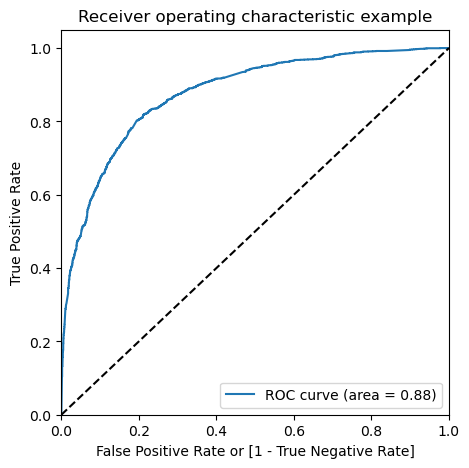

In [207]:
# Call the ROC function
draw_roc(y_train_pred_final.Converted, y_train_pred_final.Conversion_Prob)

The area under ROC curve is 0.88 which is a very good value

In [208]:
# Creating columns with different probability cutoffs 
numbers = [float(x)/10 for x in range(10)]
for i in numbers:
    y_train_pred_final[i]= y_train_pred_final.Conversion_Prob.map(lambda x: 1 if x > i else 0)
y_train_pred_final.head()

,Converted,Conversion_Prob,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
0,1,0.590077,1,1,1,1,1,1,1,0,0,0,0
1,1,0.751366,1,1,1,1,1,1,1,1,1,0,0
2,0,0.634470,1,1,1,1,1,1,1,1,0,0,0
3,1,0.124553,0,1,1,0,0,0,0,0,0,0,0
4,1,0.988995,1,1,1,1,1,1,1,1,1,1,1


In [209]:
# Creating a dataframe to see the values of accuracy, sensitivity, and specificity at different values of probabiity cutoffs
cutoff_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])
# Making confusing matrix to find values of sensitivity, accurace and specificity for each level of probablity
from sklearn.metrics import confusion_matrix
num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train_pred_final.Converted, y_train_pred_final[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,sensi,speci]
cutoff_df

,prob,accuracy,sensi,speci
0.0,0.0,0.467181,1.000000,0.000000
0.1,0.1,0.583541,0.988292,0.228651
0.2,0.2,0.714321,0.940394,0.516099
0.3,0.3,0.776728,0.879723,0.686421
0.4,0.4,0.798856,0.829164,0.772282
0.5,0.5,0.794878,0.732837,0.849277
0.6,0.6,0.783938,0.666844,0.886608
0.7,0.7,0.766285,0.585418,0.924872
0.8,0.8,0.729985,0.467270,0.960336
0.9,0.9,0.684237,0.343800,0.982734


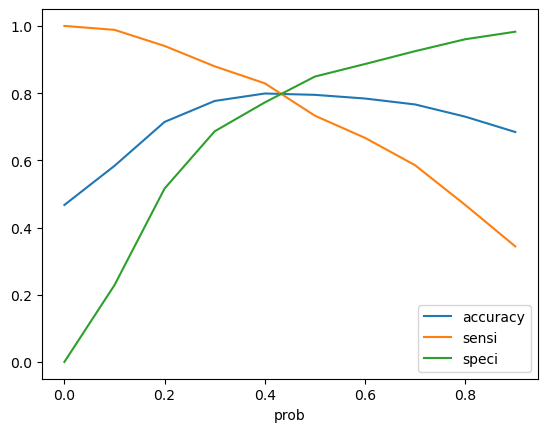

In [210]:
# Plotting graph for the above

cutoff_df.plot.line(x='prob', y=['accuracy','sensi','speci'])
plt.show()

From the graph it is visible that the optimal cut off is at 0.45.

In [219]:
y_train_pred_final['final_predicted'] = y_train_pred_final.Conversion_Prob.map( lambda x: 1 if x > 0.45 else 0)
y_train_pred_final.head()

,Converted,Conversion_Prob,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,final_predicted
0,1,0.590077,1,1,1,1,1,1,1,0,0,0,0,1
1,1,0.751366,1,1,1,1,1,1,1,1,1,0,0,1
2,0,0.634470,1,1,1,1,1,1,1,1,0,0,0,1
3,1,0.124553,0,1,1,0,0,0,0,0,0,0,0,0
4,1,0.988995,1,1,1,1,1,1,1,1,1,1,1,1


In [220]:
# Check the overall accuracy
metrics.accuracy_score(y_train_pred_final.Converted, y_train_pred_final.final_predicted)

0.8015912481352561

In [221]:
# Creating confusion matrix 
confusion2 = metrics.confusion_matrix(y_train_pred_final.Converted, y_train_pred_final.final_predicted )
confusion2

array([[1758,  385],
       [ 413, 1466]], dtype=int64)

In [222]:

# Substituting the value of true positive
TP = confusion2[1,1]
# Substituting the value of true negatives
TN = confusion2[0,0]
# Substituting the value of false positives
FP = confusion2[0,1] 
# Substituting the value of false negatives
FN = confusion2[1,0]

In [225]:
# Calculating the sensitivity
TP/(TP+FN)

0.7802022352315061

In [226]:
# Calculating the specificity
TN/(TN+FP)

0.8203453103126458

With the current cut off as 0.45 we have accuracy, sensitivity around 78% and specificity of around 82%

# Prediction on Test set

In [227]:
#Scaling numeric values
X_test[['TotalVisits', 'Page Views Per Visit', 'Total Time Spent on Website']] = scaler.transform(X_test[['TotalVisits', 'Page Views Per Visit', 'Total Time Spent on Website']])

In [228]:
col = X_train.columns

In [229]:
# Select the columns in X_train for X_test as well
X_test = X_test[col]
# Add a constant to X_test
X_test_sm = sm.add_constant(X_test[col])
X_test_sm

,const,Do Not Email,TotalVisits,Total Time Spent on Website,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Specialization_Hospitality Management,Specialization_Other_Specialization,Specialization_Retail Management,Lead Source_Olark Chat,Last Activity_Olark Chat Conversation,Last Activity_Other_Activity,Last Activity_SMS Sent,What is your current occupation_Working Professional
7656,1.0,1,0.6,0.154930,1,0,0,0,0,0,0,0,1,0
3149,1.0,0,0.2,0.107835,1,0,0,0,0,0,0,0,1,0
7878,1.0,0,0.2,0.478433,1,0,0,0,0,0,0,0,0,0
1490,1.0,0,0.5,0.665933,1,0,0,0,0,0,0,0,0,1
1189,1.0,0,0.5,0.656690,1,0,0,0,0,0,0,0,0,0
4539,1.0,0,0.0,0.000000,0,0,0,1,0,1,0,0,1,0
6448,1.0,0,0.0,0.000000,0,0,0,1,0,1,0,0,0,0
8456,1.0,1,0.3,0.047535,0,0,0,1,0,0,0,0,0,0
8357,1.0,1,0.3,0.122359,1,0,0,0,0,0,0,0,0,0
1062,1.0,0,0.6,0.304577,0,0,0,0,0,0,1,0,0,0


In [230]:
# Storing prediction of test set in the variable 'y_test_pred'
y_test_pred = res.predict(X_test_sm)
# Coverting it to df
y_pred_df = pd.DataFrame(y_test_pred)
# Converting y_test to dataframe
y_test_df = pd.DataFrame(y_test)
# Remove index for both dataframes to append them side by side 
y_pred_df.reset_index(drop=True, inplace=True)
y_test_df.reset_index(drop=True, inplace=True)
# Append y_test_df and y_pred_df
y_pred_final = pd.concat([y_test_df, y_pred_df],axis=1)
# Renaming column 
y_pred_final= y_pred_final.rename(columns = {0 : 'Conversion_Prob'})
y_pred_final.head()

,Converted,Conversion_Prob
0,0,0.169251
1,1,0.340020
2,0,0.472633
3,1,0.970404
4,1,0.726077


In [231]:
# Making prediction using cut off 0.45
y_pred_final['final_predicted'] = y_pred_final.Conversion_Prob.map(lambda x: 1 if x > 0.45 else 0)
y_pred_final

,Converted,Conversion_Prob,final_predicted
0,0,0.169251,0
1,1,0.340020,0
2,0,0.472633,1
3,1,0.970404,1
4,1,0.726077,1
5,1,0.444788,0
6,0,0.206760,0
7,0,0.019147,0
8,0,0.041522,0
9,0,0.272051,0


In [232]:
# Check the overall accuracy
metrics.accuracy_score(y_pred_final['Converted'], y_pred_final.final_predicted)

0.7965217391304348

In [233]:
# Creating confusion matrix 
confusion2 = metrics.confusion_matrix(y_pred_final['Converted'], y_pred_final.final_predicted )
confusion2

array([[801, 188],
       [163, 573]], dtype=int64)

In [234]:
# Substituting the value of true positive
TP = confusion2[1,1]
# Substituting the value of true negatives
TN = confusion2[0,0]
# Substituting the value of false positives
FP = confusion2[0,1] 
# Substituting the value of false negatives
FN = confusion2[1,0]

In [235]:
# Calculating the sensitivity
TP/(TP+FN)

0.7785326086956522

In [236]:
# Calculating the specificity
TN/(TN+FP)

0.8099089989888777

With the current cut off as 0.45 we have accuracy of 80%, sensitivity around 78% and specificity of around 81%

# Precision-Recall

In [237]:
confusion = metrics.confusion_matrix(y_train_pred_final.Converted, y_train_pred_final.Predicted )
confusion

array([[1820,  323],
       [ 502, 1377]], dtype=int64)

In [238]:
# Precision = TP / TP + FP
confusion[1,1]/(confusion[0,1]+confusion[1,1])

0.81

In [239]:
#Recall = TP / TP + FN
confusion[1,1]/(confusion[1,0]+confusion[1,1])

0.7328366152208622

With the current cut off as 0.45 we have Precision around 81% and Recall around 73%

In [240]:
from sklearn.metrics import precision_recall_curve

In [241]:
y_train_pred_final.Converted, y_train_pred_final.Predicted

(0       1
 1       1
 2       0
 3       1
 4       1
 5       0
 6       1
 7       0
 8       0
 9       0
 10      0
 11      0
 12      1
 13      0
 14      0
 15      0
 16      1
 17      1
 18      1
 19      1
 20      0
 21      0
 22      1
 23      1
 24      1
 25      1
 26      0
 27      0
 28      0
 29      0
 30      1
 31      0
 32      1
 33      0
 34      1
 35      1
 36      0
 37      1
 38      0
 39      1
 40      1
 41      0
 42      1
 43      1
 44      1
 45      0
 46      1
 47      0
 48      1
 49      0
 50      1
 51      1
 52      1
 53      0
 54      1
 55      1
 56      0
 57      1
 58      0
 59      1
 60      0
 61      0
 62      0
 63      0
 64      1
 65      1
 66      0
 67      0
 68      1
 69      1
 70      0
 71      0
 72      1
 73      0
 74      0
 75      0
 76      1
 77      1
 78      1
 79      0
 80      0
 81      0
 82      0
 83      0
 84      0
 85      1
 86      1
 87      1
 88      0
 89      1
 90      0

In [242]:
p, r, thresholds = precision_recall_curve(y_train_pred_final.Converted, y_train_pred_final.Conversion_Prob)

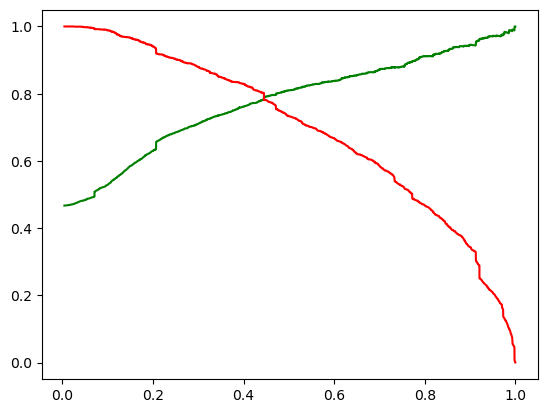

In [243]:
# plotting graph
plt.plot(thresholds, p[:-1], "g-")
plt.plot(thresholds, r[:-1], "r-")
plt.show()

In [250]:
y_train_pred_final['final_predicted'] = y_train_pred_final.Conversion_Prob.map(lambda x: 1 if x > 0.46 else 0)
y_train_pred_final.head()

,Converted,Conversion_Prob,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,final_predicted
0,1,0.590077,1,1,1,1,1,1,1,0,0,0,0,1
1,1,0.751366,1,1,1,1,1,1,1,1,1,0,0,1
2,0,0.634470,1,1,1,1,1,1,1,1,0,0,0,1
3,1,0.124553,0,1,1,0,0,0,0,0,0,0,0,0
4,1,0.988995,1,1,1,1,1,1,1,1,1,1,1,1


In [251]:
# Accuracy
metrics.accuracy_score(y_train_pred_final.Converted, y_train_pred_final.final_predicted)

0.8013426156141223

In [252]:
# Creating confusion matrix again
confusion2 = metrics.confusion_matrix(y_train_pred_final.Converted, y_train_pred_final.final_predicted )
confusion2

array([[1769,  374],
       [ 425, 1454]], dtype=int64)

In [253]:
# Substituting the value of true positive
TP = confusion2[1,1]
# Substituting the value of true negatives
TN = confusion2[0,0]
# Substituting the value of false positives
FP = confusion2[0,1] 
# Substituting the value of false negatives
FN = confusion2[1,0]

In [254]:
# Precision = TP / TP + FP
TP / (TP + FP)

0.7954048140043763

In [255]:
#Recall = TP / TP + FN
TP / (TP + FN)

0.7738158594997339

With the current cut off as 0.45 we have Precision around 79.5% and Recall around 77% and accuracy 80%.

# Prediction on Test set

In [256]:
# Storing prediction of test set in the variable 'y_test_pred'
y_test_pred = res.predict(X_test_sm)
# Coverting it to df
y_pred_df = pd.DataFrame(y_test_pred)
# Converting y_test to dataframe
y_test_df = pd.DataFrame(y_test)
# Remove index for both dataframes to append them side by side 
y_pred_df.reset_index(drop=True, inplace=True)
y_test_df.reset_index(drop=True, inplace=True)
# Append y_test_df and y_pred_df
y_pred_final = pd.concat([y_test_df, y_pred_df],axis=1)
# Renaming column 
y_pred_final= y_pred_final.rename(columns = {0 : 'Conversion_Prob'})
y_pred_final.head()

,Converted,Conversion_Prob
0,0,0.169251
1,1,0.340020
2,0,0.472633
3,1,0.970404
4,1,0.726077


In [257]:
# Making prediction using cut off 0.46
y_pred_final['final_predicted'] = y_pred_final.Conversion_Prob.map(lambda x: 1 if x > 0.46 else 0)
y_pred_final

,Converted,Conversion_Prob,final_predicted
0,0,0.169251,0
1,1,0.340020,0
2,0,0.472633,1
3,1,0.970404,1
4,1,0.726077,1
5,1,0.444788,0
6,0,0.206760,0
7,0,0.019147,0
8,0,0.041522,0
9,0,0.272051,0


In [258]:
# Check the overall accuracy
metrics.accuracy_score(y_pred_final['Converted'], y_pred_final.final_predicted)

0.7971014492753623

In [259]:
# Creating confusion matrix 
confusion2 = metrics.confusion_matrix(y_pred_final['Converted'], y_pred_final.final_predicted )
confusion2

array([[807, 182],
       [168, 568]], dtype=int64)

In [260]:
# Substituting the value of true positive
TP = confusion2[1,1]
# Substituting the value of true negatives
TN = confusion2[0,0]
# Substituting the value of false positives
FP = confusion2[0,1] 
# Substituting the value of false negatives
FN = confusion2[1,0]

In [261]:
# Precision = TP / TP + FP
TP / (TP + FP)

0.7573333333333333

In [262]:
#Recall = TP / TP + FN
TP / (TP + FN)

0.7717391304347826

With the current cut off as 0.46 we have Precision around 75.7% , Recall around 77.2% and accuracy 79.7%.

# Conclusion
It was found that the variables that mattered the most in the potential buyers are:

1. Lead Origin_Landing Page Submission
2. TotalVisits
3. Total Time Spent on Website
4. Specialization_Other_Specialization
5. Last Activity_SMS Sent
6. Lead Source_Olark Chat
7. Last Activity_Olark Chat Conversation
8. What is your current occupation_Working Profes...
9. Lead Origin_Lead Add Form
10. Do Not Email
11. Specialization_Hospitality Management
12. Specialization_Retail Management
13. Last Activity_Other_Activity	